In [1]:
import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.timmean.nc')

In [3]:
spatial_data = spatial_data['tx10pETCCDI'].squeeze()

In [4]:
spatial_data


<xarray.DataArray 'tx10pETCCDI' (lat: 35, lon: 40)>
[1400 values with dtype=float32]
Coordinates:
    time     object 1932-07-02 00:00:00
  * lon      (lon) float64 60.62 61.88 63.13 64.38 ... 105.6 106.9 108.1 109.4
  * lat      (lat) float64 5.5 6.5 7.5 8.5 9.5 10.5 ... 35.5 36.5 37.5 38.5 39.5
Attributes:
    long_name:      Percentage of Days when Daily Maximum Temperature is Belo...
    units:          %
    cell_methods:   area: mean time: maximum
    cell_measures:  area: areacella
    interp_method:  conserve_order2
    original_name:  tasmax
    history:        Created by climdex.pcic 1.1.9.1 on Mon Jul  8 09:01:08 2019
    base_period:    1981-2010

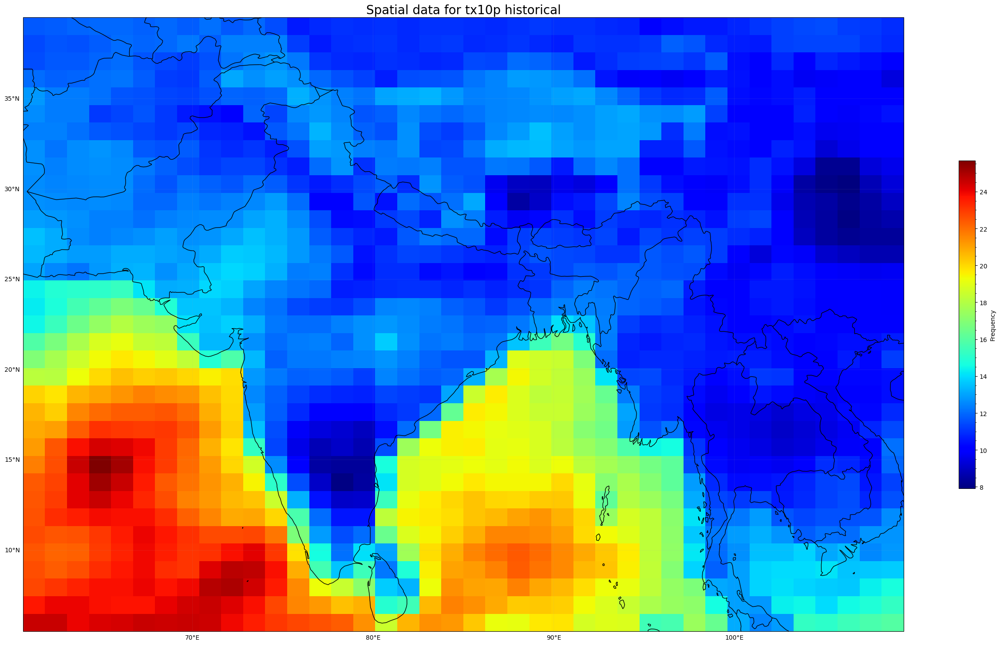

In [5]:
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Spatial data for tx10p historical', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
# ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()

In [6]:
## Lets try and calculate the timeseries data now 

tx10p = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')
tx10p = tx10p['tx10pETCCDI']
tx10p

<xarray.DataArray 'tx10pETCCDI' (time: 165, lat: 35, lon: 40)>
[231000 values with dtype=float32]
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00
  * lon      (lon) float64 60.62 61.88 63.13 64.38 ... 105.6 106.9 108.1 109.4
  * lat      (lat) float64 5.5 6.5 7.5 8.5 9.5 10.5 ... 35.5 36.5 37.5 38.5 39.5
Attributes:
    long_name:      Percentage of Days when Daily Maximum Temperature is Belo...
    units:          %
    cell_methods:   area: mean time: maximum
    cell_measures:  area: areacella
    interp_method:  conserve_order2
    original_name:  tasmax
    history:        Created by climdex.pcic 1.1.9.1 on Mon Jul  8 09:01:08 2019
    base_period:    1981-2010

In [7]:
## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_fldmean = tx10p.mean(dim=['lat','lon'])
tx10p_fldmean

<xarray.DataArray 'tx10pETCCDI' (time: 165)>
array([23.295694 , 14.345597 , 14.461839 , 14.234246 , 13.010371 ,
        9.634051 , 19.614872 , 17.896086 , 14.033659 , 14.139922 ,
       16.743639 , 14.627789 , 17.60313  , 21.883953 , 26.179062 ,
       16.464773 , 12.911938 , 13.679256 , 13.162232 , 16.509197 ,
       13.049118 , 14.928181 ,  9.754208 , 12.1182   , 21.109196 ,
       13.984736 , 12.223876 , 14.559688 , 14.151467 , 20.99139  ,
       23.164383 , 18.431507 , 20.51859  , 23.196869 , 31.684542 ,
       23.766535 , 17.263405 , 20.270254 , 17.66047  , 18.415264 ,
       15.252249 , 13.457728 , 12.845402 , 11.99178  , 14.172994 ,
       14.672016 , 13.558123 , 11.48728  , 18.045403 , 18.404696 ,
       16.396086 , 13.650882 , 15.604305 , 18.864775 , 17.147161 ,
       20.027985 , 18.076124 , 13.6182   , 15.550488 , 12.861448 ,
       19.16634  , 13.090215 , 12.718003 , 14.445011 , 14.7      ,
       14.813501 , 17.330137 , 16.739332 , 16.535421 , 16.215656 ,
       16.28826  , 17.258318 , 15.227985 , 12.688455 , 15.709198 ,
       13.124267 , 14.577887 , 12.949315 , 12.900979 , 16.065754 ,
       13.378864 , 13.381214 , 18.421135 , 14.415264 , 12.426614 ,
       11.40548  , 11.05088  , 12.119961 , 16.00372  , 13.185519 ,
       11.068101 , 11.787279 , 12.198043 , 15.724071 , 14.506263 ,
       11.89902  , 14.155773 , 10.9039135, 12.418786 ,  8.376712 ,
       10.470254 ,  8.997848 ,  8.721135 ,  9.630919 , 12.802153 ,
       15.345793 , 11.148727 ,  9.817417 , 13.631507 , 12.76771  ,
       13.107631 , 17.46497  , 23.06771  , 15.996282 , 21.723288 ,
       18.084345 , 19.074558 , 13.627984 , 16.481604 , 12.145792 ,
       12.802936 , 12.032877 , 10.963405 , 13.10646  , 12.116831 ,
       19.782583 ,  8.89589  , 12.979061 , 16.498434 , 10.172604 ,
       10.209785 , 16.101963 , 13.750624 , 13.155246 , 11.681577 ,
       13.066509 , 13.483757 ,  8.452885 ,  8.066388 ,  8.353316 ,
       13.319023 , 12.827309 , 18.954607 , 15.680234 , 16.774277 ,
       13.818895 ,  9.470734 ,  8.130239 ,  7.6664553,  9.679154 ,
       10.383595 ,  7.1916323,  8.6285715,  6.9665027,  7.517815 ,
        8.399062 ,  6.023881 , 11.115906 ,  6.364613 ,  8.87215  ,
        5.13756  ,  5.209198 ,  6.0906067,  5.4136987,  4.803718 ],
      dtype=float32)
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00

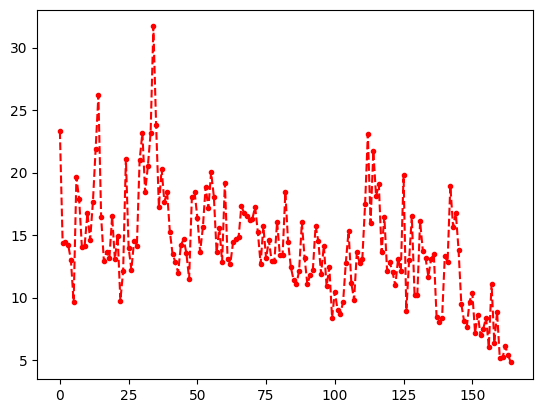

In [8]:
## plotting the timeseries and seeing what I get 
from matplotlib.dates import date2num

dates = date2num(tx10p_fldmean['time'].values)

plt.plot(tx10p_fldmean,'r.--')

/tmp/ipykernel_123693/2779861367.py:7: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_fldmean['time'] = tx10p_fldmean.indexes['time'].to_datetimeindex()


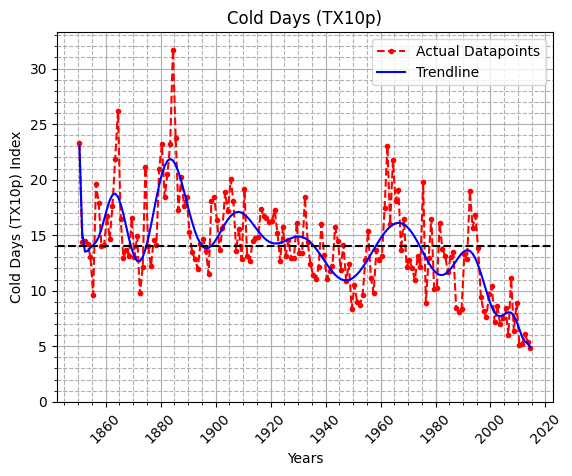

In [9]:
import pandas as pd
data_mean = tx10p_fldmean.mean().item()
data_std = tx10p_fldmean.std().item()

x = date2num(tx10p_fldmean['time'].values)

tx10p_fldmean['time'] = tx10p_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_fldmean, 21)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_fldmean.max()
fig, ax = plt.subplots()

ax.plot(tx10p_fldmean['time'], tx10p_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_fldmean['time'], trendline, 'b-', label='Trendline')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_fldmean['time'], [max_height]*len(tx10p_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')

plt.show()




In [10]:
## trying to calculate spatial trend of each grid points 

import netCDF4
import numpy as np 
from scipy import stats


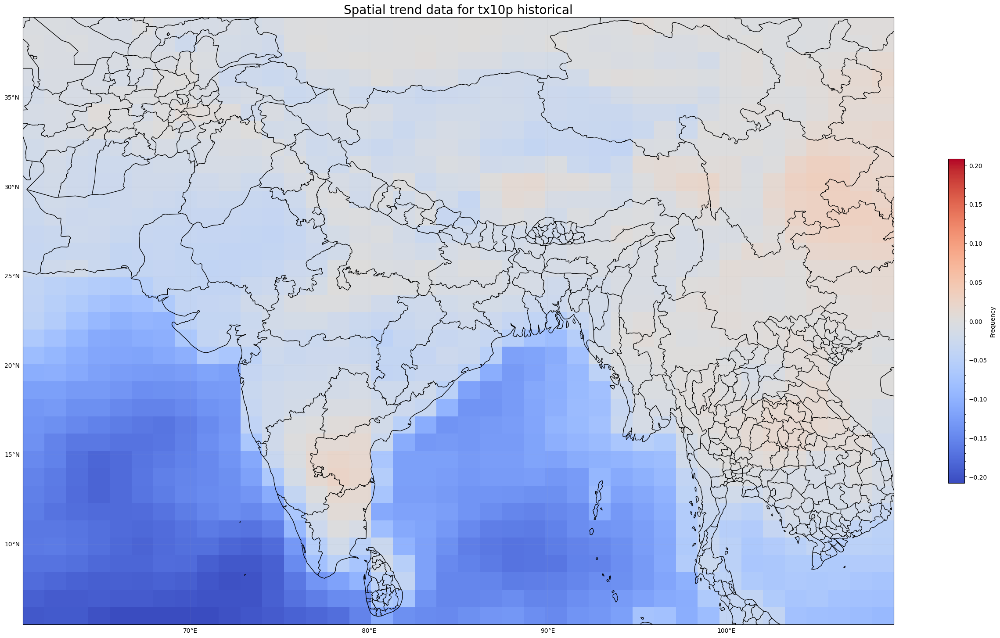

In [11]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = spatial_data.lat
lon = spatial_data.lon

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)




fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))



mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

plt.title('Spatial trend data for tx10p historical', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


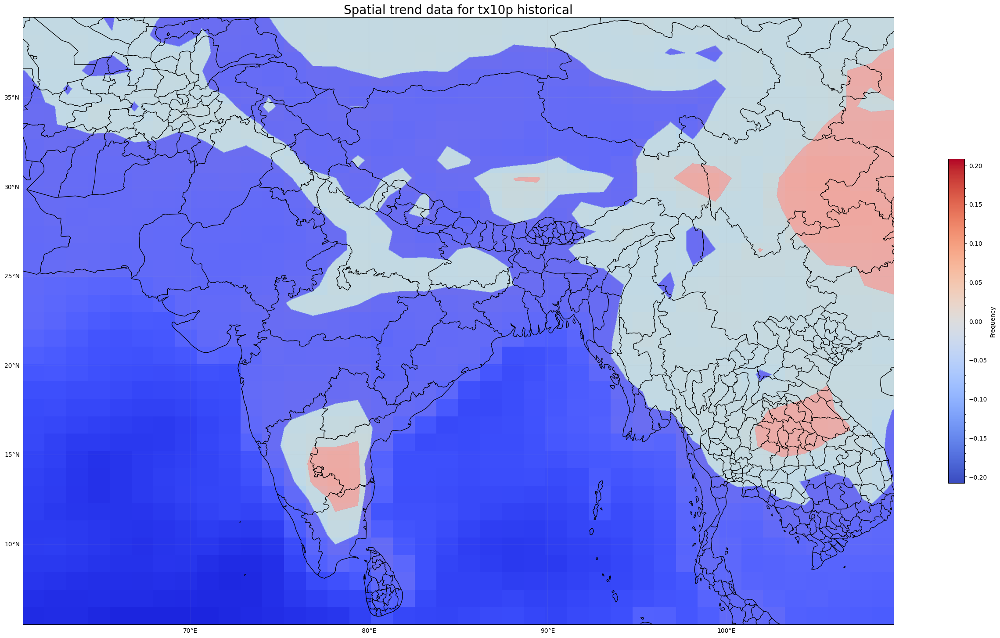

In [12]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = spatial_data.lat
lon = spatial_data.lon

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)




# ... (previous code remains unchanged)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

# Draw filled contour plots to highlight positive and negative trends
contour_level = 0.01  # Adjust this value to change the distance between contour lines
contours = ax.contourf(lon, lat, trend, levels=[-max_abs_value, -contour_level, contour_level, max_abs_value], colors=['blue', 'lightblue', 'lightcoral', 'red'], alpha=0.5, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for tx10p historical', fontsize=20)

# ... (rest of the code remains unchanged)



states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


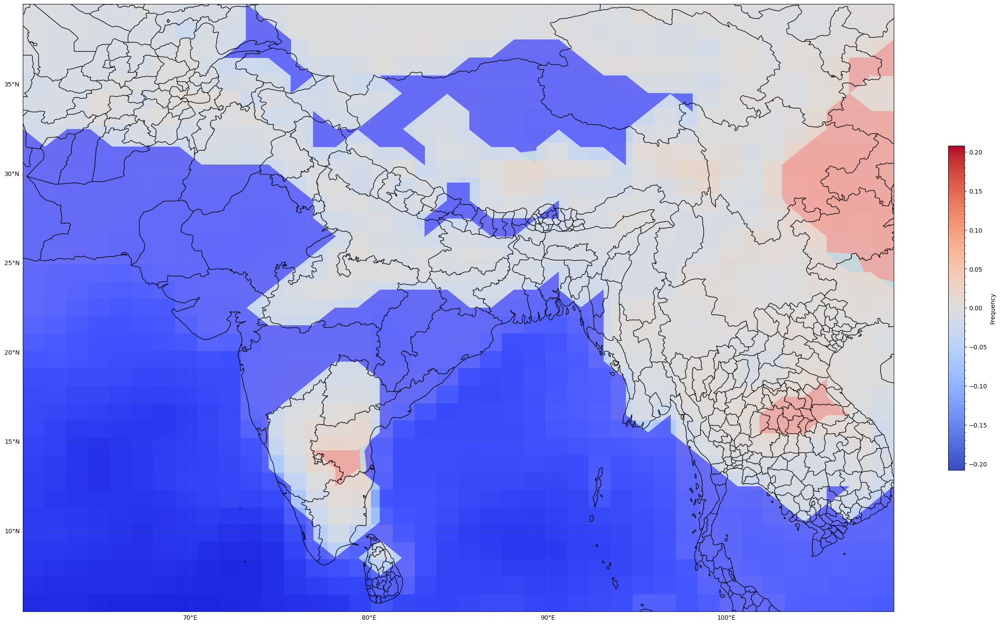

In [13]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = spatial_data.lat
lon = spatial_data.lon

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)




# ... (previous code remains unchanged)

# Create a mask for p-values below the threshold
p_value_threshold = 0.05
significant = p_values < p_value_threshold

# Apply the mask to the trend data
masked_trend = np.ma.array(trend, mask=np.logical_not(significant))

# ... (rest of the code remains unchanged)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

# Draw filled contour plots to highlight significant positive and negative trends
contours = ax.contourf(lon, lat, masked_trend, levels=[-max_abs_value, -contour_level, contour_level, max_abs_value], colors=['blue', 'lightblue', 'lightcoral', 'red'], alpha=0.5, transform=ccrs.PlateCarree())

# ... (rest of the code remains unchanged)



states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


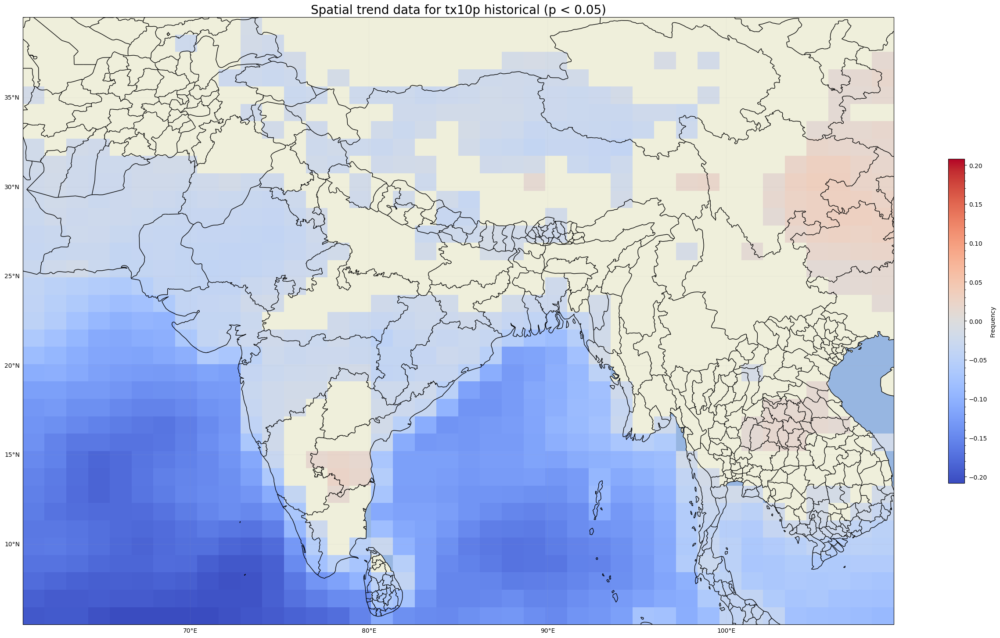

In [14]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = spatial_data.lat
lon = spatial_data.lon

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)




# ... (previous code remains unchanged)

# Create a mask for p-values below the threshold
p_value_threshold = 0.05
significant = p_values < p_value_threshold

# Apply the mask to the trend data
masked_trend = np.ma.array(trend, mask=np.logical_not(significant))

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

# Display the masked trend data
mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

# ... (rest of the code remains unchanged)

plt.title('Spatial trend data for tx10p historical (p < 0.05)', fontsize=20)

# ... (rest of the code remains unchanged)


states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


### Final structured pipeline for each question

#### Spatial plot of climatology of tx10p climate index for the historical period (1851-2014) over (60E-100E, 5-40N)
 

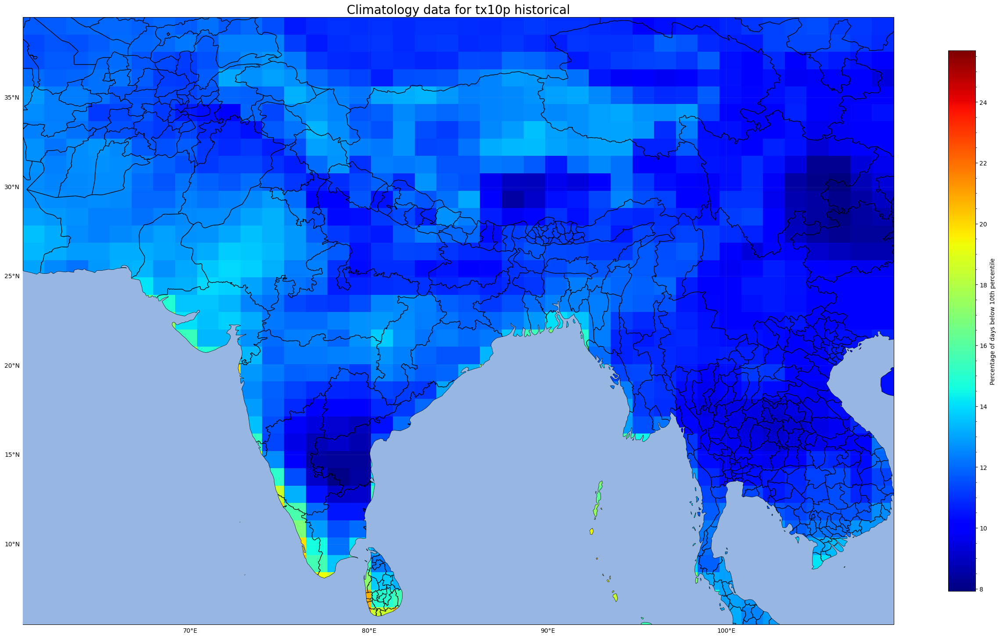

In [15]:
## climatology spatial plot 

# importing the important libraries 

import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# reading the data

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.timmean.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.squeeze()

# plotting the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Climatology data for tx10p historical', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder=100)


cbar = fig.colorbar(mp, shrink=0.5,label='Percentage of days below 10th percentile')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology.png', dpi=600, bbox_inches='tight')
plt.show()


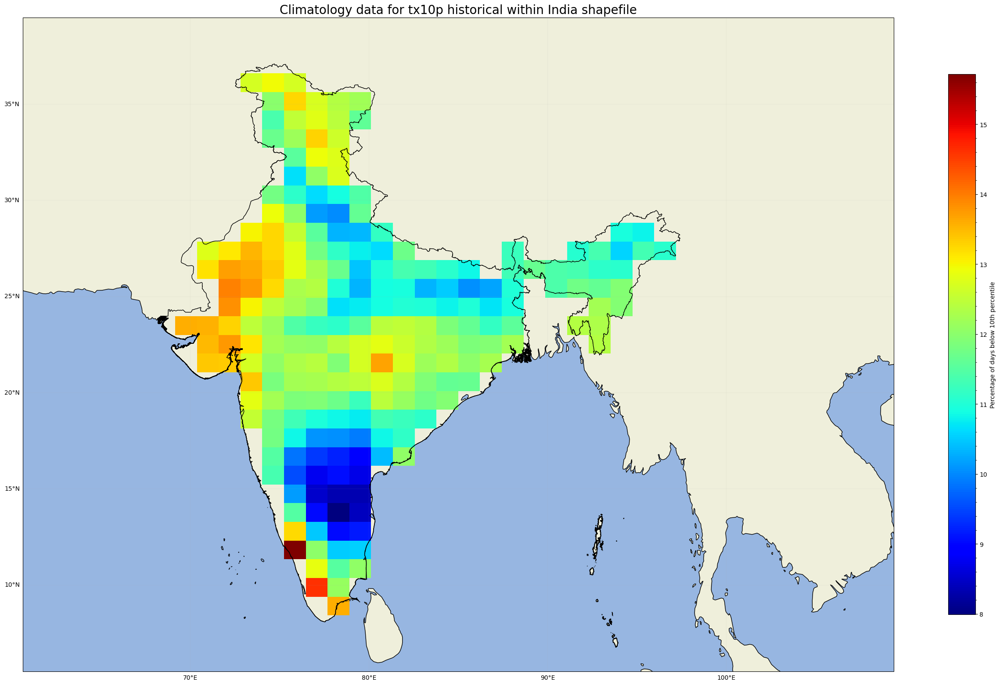

In [263]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

# Function to create mask from shapefile
def create_mask_from_shapefile(dataset, shapefile_gdf):
    lon, lat = np.meshgrid(dataset.lon.values, dataset.lat.values)
    india_shape = shapefile_gdf.geometry.iloc[0]
    mask = np.zeros_like(dataset)

    for i, row in enumerate(lat):
        for j, col in enumerate(lon[0]):
            if india_shape.contains(Point(lon[i, j], lat[i, j])):
                mask[i, j] = 1

    return mask

# Read the data
spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.timmean.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.squeeze()

# Read India boundary shapefile
india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

# Create mask using the India shapefile
mask = create_mask_from_shapefile(spatial_data, india_gdf)
masked_data = spatial_data.where(mask == 1, np.nan)

# Plot the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(masked_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='jet', origin='lower')
plt.title('Climatology data for tx10p historical within India shapefile', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)

cbar = fig.colorbar(mp, shrink=0.5, label='Percentage of days below 10th percentile')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology-india-shapefile.png', dpi=600, bbox_inches='tight')
plt.show()


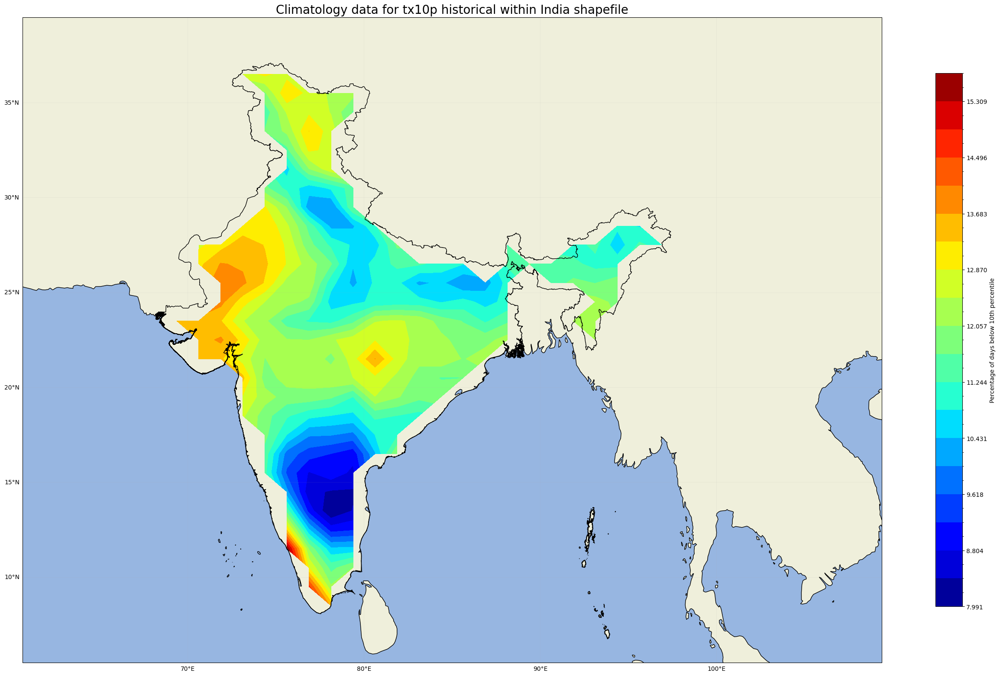

In [260]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

# Function to create mask from shapefile
def create_mask_from_shapefile(dataset, shapefile_gdf):
    lon, lat = np.meshgrid(dataset.lon.values, dataset.lat.values)
    india_shape = shapefile_gdf.geometry.iloc[0]
    mask = np.zeros_like(dataset)

    for i, row in enumerate(lat):
        for j, col in enumerate(lon[0]):
            if india_shape.contains(Point(lon[i, j], lat[i, j])):
                mask[i, j] = 1

    return mask

# Read the data
spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.timmean.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.squeeze()

# Read India boundary shapefile
india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

# Create mask using the India shapefile
mask = create_mask_from_shapefile(spatial_data, india_gdf)
masked_data = spatial_data.where(mask == 1, np.nan)

# Plot the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

# Use contourf for smooth data visualization
contour_levels = np.linspace(masked_data.min(), masked_data.max(), 20)
mp = ax.contourf(lon, lat, masked_data, levels=contour_levels, cmap='jet', transform=ccrs.PlateCarree())

plt.title('Climatology data for tx10p historical within India shapefile', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)

cbar = fig.colorbar(mp, shrink=0.5, label='Percentage of days below 10th percentile')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology-india-shapefile-contourf.png', dpi=600, bbox_inches='tight')
plt.show()


#### Spatial trend of tx10p index data for the historical period (1850-2014) for the same region 

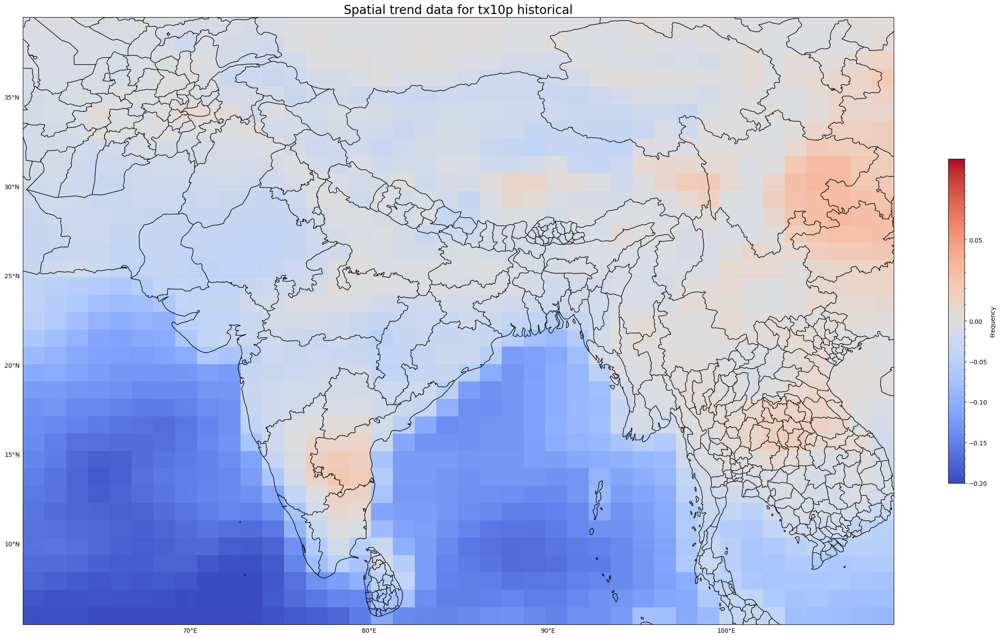

In [19]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]


# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-0.20, vcenter=0, vmax=0.10)




fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))



mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

plt.title('Spatial trend data for tx10p historical', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/spatial-trend-historical.png', dpi=300, bbox_inches='tight')
plt.show()


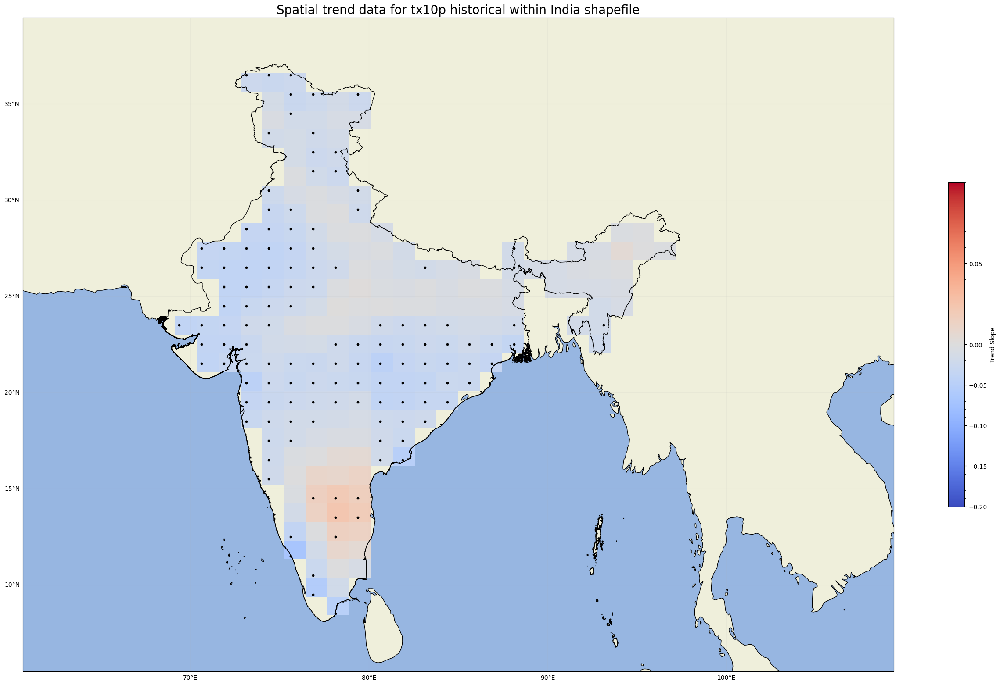

In [264]:
import netCDF4
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from matplotlib.colors import TwoSlopeNorm
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
from shapely.geometry import Point

# Read the NetCDF data and calculate trend and p_values
# (Same as the original code, no changes here)


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]


# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-0.20, vcenter=0, vmax=0.10)


# Read India boundary shapefile
india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

def create_mask_from_shapefile(lon, lat, shapefile_gdf):
    lon_mesh, lat_mesh = np.meshgrid(lon, lat)
    india_shape = shapefile_gdf.geometry.iloc[0]
    mask = np.zeros_like(lat_mesh)

    for i, row in enumerate(lat_mesh):
        for j, col in enumerate(lon_mesh[0]):
            if india_shape.contains(Point(lon_mesh[i, j], lat_mesh[i, j])):
                mask[i, j] = 1

    return mask

# Create mask using the India shapefile
mask = create_mask_from_shapefile(lon, lat, india_gdf)
masked_trend = np.where(mask == 1, trend, np.nan)

# Rest of the plotting code remains the same

# Normalize the colorbar
max_abs_value = np.max(np.abs(masked_trend))
norm = TwoSlopeNorm(vmin=-0.20, vcenter=0, vmax=0.10)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)
plt.title('Spatial trend data for tx10p historical within India shapefile', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)

# Add black dots for significant trends (p < 0.05)
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
significant_trend = np.where((mask == 1) & (p_values < 0.05))
ax.scatter(lon_mesh[significant_trend], lat_mesh[significant_trend], color='black', s=10, transform=ccrs.PlateCarree())


cbar = fig.colorbar(mp, shrink=0.3, label='Trend Slope')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/spatial-trend-historical-india-shapefile.png', dpi=600, bbox_inches='tight')
plt.show()


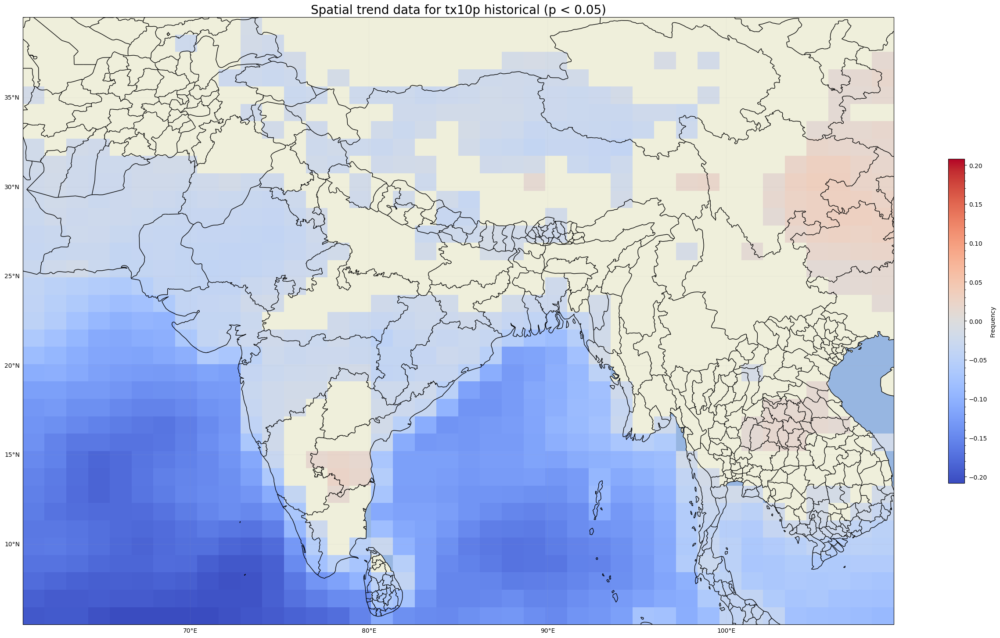

In [17]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]


# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)



# Create a mask for p-values below the threshold
p_value_threshold = 0.05
significant = p_values < p_value_threshold

# Apply the mask to the trend data
masked_trend = np.ma.array(trend, mask=np.logical_not(significant))

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

# Display the masked trend data
mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


plt.title('Spatial trend data for tx10p historical (p < 0.05)', fontsize=20)



states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


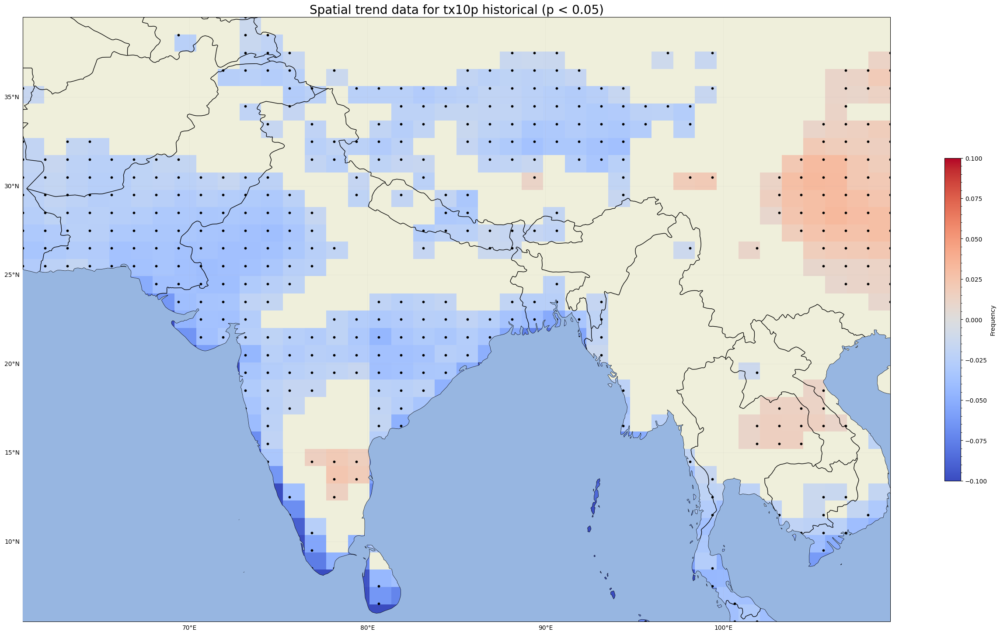

In [18]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]





# Create a mask for p-values below the threshold
p_value_threshold = 0.05
significant = p_values < p_value_threshold

# Create a new masked array using the significant data
significant_masked = np.ma.array(trend, mask=significant)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

# Display the masked trend data
mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower',vmin=-0.10,vmax=0.10)

# Get the latitudes and longitudes of the significant data points
significant_lat, significant_lon = np.where(significant)
lats, lons = np.meshgrid(lat, lon)

# Overlay the significant dots on the plot
ax.scatter(lons[significant_lon, significant_lat], lats[significant_lon, significant_lat], s=10, c='black', zorder=2, transform=ccrs.PlateCarree())

# (All your code for finishing the plot stays the same)


# # Display the masked trend data
# mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


plt.title('Spatial trend data for tx10p historical (p < 0.05)', fontsize=20)



states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
# ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


#### Timeseries for various regions of India 

/tmp/ipykernel_124115/3494734649.py:18: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_north_india_fldmean['time'] = tx10p_north_india_fldmean.indexes['time'].to_datetimeindex()


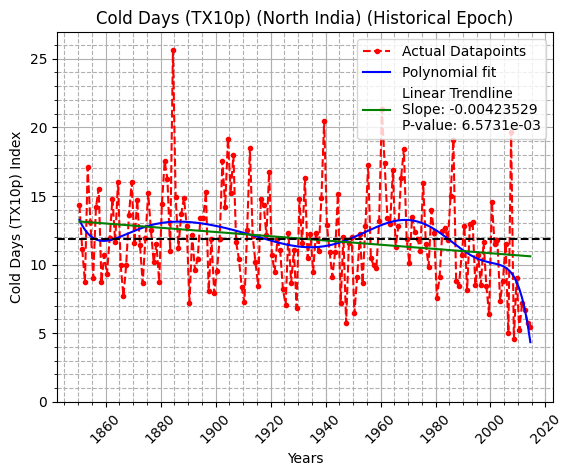

In [214]:
## Timeseries data for North India

tx10p_north_india = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.north_india.nc')
tx10p_north_india = tx10p_north_india['tx10pETCCDI']
tx10p_north_india

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_north_india_fldmean = tx10p_north_india.mean(dim=['lat','lon'])
tx10p_north_india_fldmean

import pandas as pd
data_mean = tx10p_north_india_fldmean.mean().item()
data_std = tx10p_north_india_fldmean.std().item()

x = date2num(tx10p_north_india_fldmean['time'].values)

tx10p_north_india_fldmean['time'] = tx10p_north_india_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_north_india_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_north_india_fldmean.max()

from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_north_india_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_north_india_fldmean['time'], tx10p_north_india_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_north_india_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_north_india_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_north_india_fldmean['time'], [max_height]*len(tx10p_north_india_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (North India) (Historical Epoch)')
ax.legend(loc='upper right')
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
# plt.xlim(1850,2014)
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.north_india_hist.png', dpi=600, bbox_inches='tight')

plt.show()





/tmp/ipykernel_124115/141860507.py:18: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_central_india_fldmean['time'] = tx10p_central_india_fldmean.indexes['time'].to_datetimeindex()


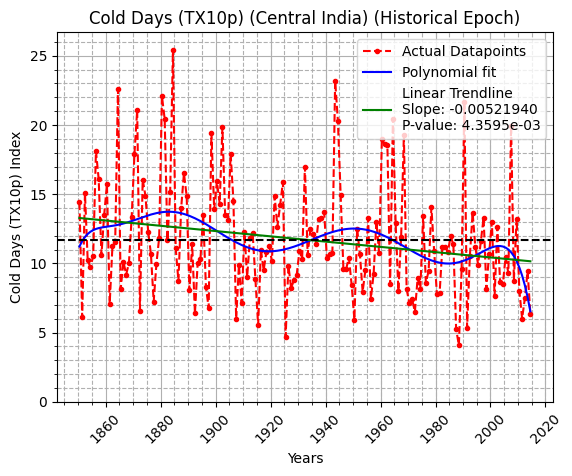

In [217]:
## Timeseries data for Central India

tx10p_central_india = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.central_india.nc')
tx10p_central_india = tx10p_central_india['tx10pETCCDI']
tx10p_central_india

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_central_india_fldmean = tx10p_central_india.mean(dim=['lat','lon'])
tx10p_central_india_fldmean

import pandas as pd
data_mean = tx10p_central_india_fldmean.mean().item()
data_std = tx10p_central_india_fldmean.std().item()

x = date2num(tx10p_central_india_fldmean['time'].values)

tx10p_central_india_fldmean['time'] = tx10p_central_india_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_central_india_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_central_india_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_central_india_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_central_india_fldmean['time'], tx10p_central_india_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_central_india_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_central_india_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_central_india_fldmean['time'], [max_height]*len(tx10p_central_india_fldmean), alpha=0.3, width=1)


ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (Central India) (Historical Epoch)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.central_india_hist.png', dpi=600, bbox_inches='tight')
plt.show()




/tmp/ipykernel_124115/4087188584.py:18: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_west_india_fldmean['time'] = tx10p_west_india_fldmean.indexes['time'].to_datetimeindex()


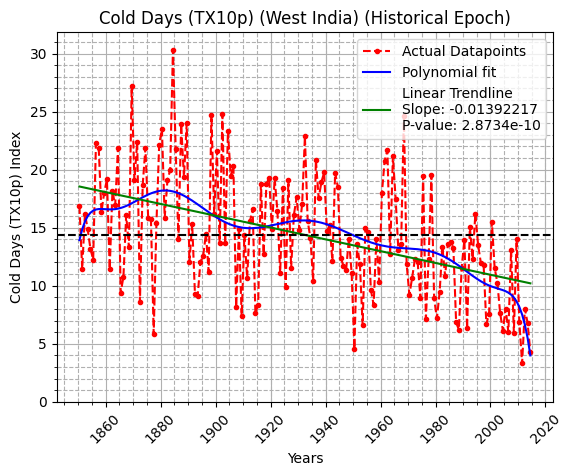

In [219]:
# Timeseries for west India

tx10p_west_india = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.west_india.nc')
tx10p_west_india = tx10p_west_india['tx10pETCCDI']
tx10p_west_india

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_west_india_fldmean = tx10p_west_india.mean(dim=['lat','lon'])
tx10p_west_india_fldmean

import pandas as pd
data_mean = tx10p_west_india_fldmean.mean().item()
data_std = tx10p_west_india_fldmean.std().item()

x = date2num(tx10p_west_india_fldmean['time'].values)

tx10p_west_india_fldmean['time'] = tx10p_west_india_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_west_india_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_west_india_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_west_india_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_west_india_fldmean['time'], tx10p_west_india_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_west_india_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_west_india_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_west_india_fldmean['time'], [max_height]*len(tx10p_west_india_fldmean), alpha=0.3, width=1)


ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (West India) (Historical Epoch)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.west_india_hist.png', dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/3646679047.py:18: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_east_india_fldmean['time'] = tx10p_east_india_fldmean.indexes['time'].to_datetimeindex()


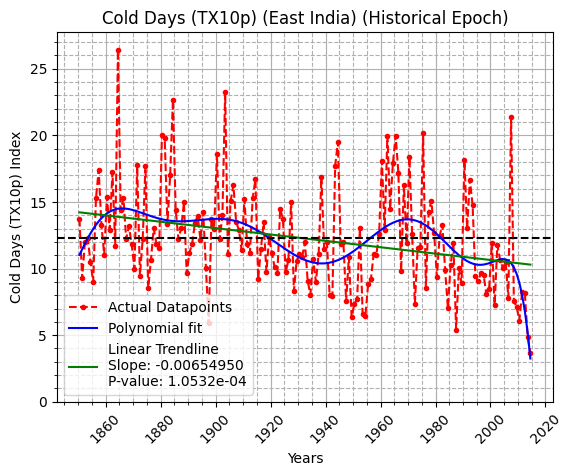

In [220]:
# Timeseries for east India

tx10p_east_india = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.east_india.nc')
tx10p_east_india = tx10p_east_india['tx10pETCCDI']
tx10p_east_india

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_east_india_fldmean = tx10p_east_india.mean(dim=['lat','lon'])
tx10p_east_india_fldmean

import pandas as pd
data_mean = tx10p_east_india_fldmean.mean().item()
data_std = tx10p_east_india_fldmean.std().item()

x = date2num(tx10p_east_india_fldmean['time'].values)

tx10p_east_india_fldmean['time'] = tx10p_east_india_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_east_india_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_east_india_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_east_india_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_east_india_fldmean['time'], tx10p_east_india_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_east_india_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_east_india_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_east_india_fldmean['time'], [max_height]*len(tx10p_east_india_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (East India) (Historical Epoch)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.east_india_hist.png',dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/4239294276.py:18: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_south_india_fldmean['time'] = tx10p_south_india_fldmean.indexes['time'].to_datetimeindex()


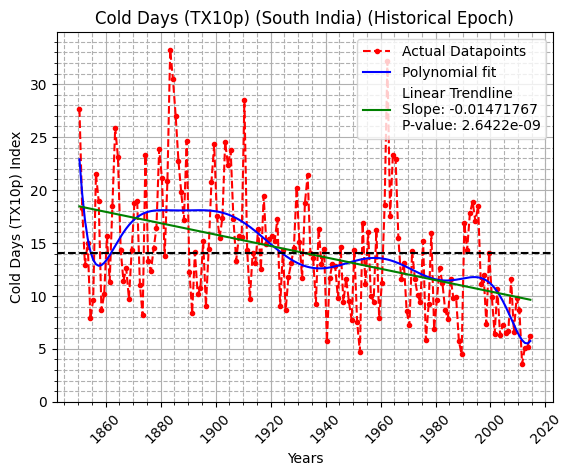

In [221]:
# Timeseries for south India

tx10p_south_india = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.south_india.nc')
tx10p_south_india = tx10p_south_india['tx10pETCCDI']
tx10p_south_india

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_south_india_fldmean = tx10p_south_india.mean(dim=['lat','lon'])
tx10p_south_india_fldmean

import pandas as pd
data_mean = tx10p_south_india_fldmean.mean().item()
data_std = tx10p_south_india_fldmean.std().item()

x = date2num(tx10p_south_india_fldmean['time'].values)

tx10p_south_india_fldmean['time'] = tx10p_south_india_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_south_india_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_south_india_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_south_india_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_south_india_fldmean['time'], tx10p_south_india_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_south_india_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_south_india_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_south_india_fldmean['time'], [max_height]*len(tx10p_south_india_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (South India) (Historical Epoch)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.south_india_hist.png',dpi=600, bbox_inches='tight')
plt.show()


Cold Days (tx10p) future projections

Spatial plot for climatology 

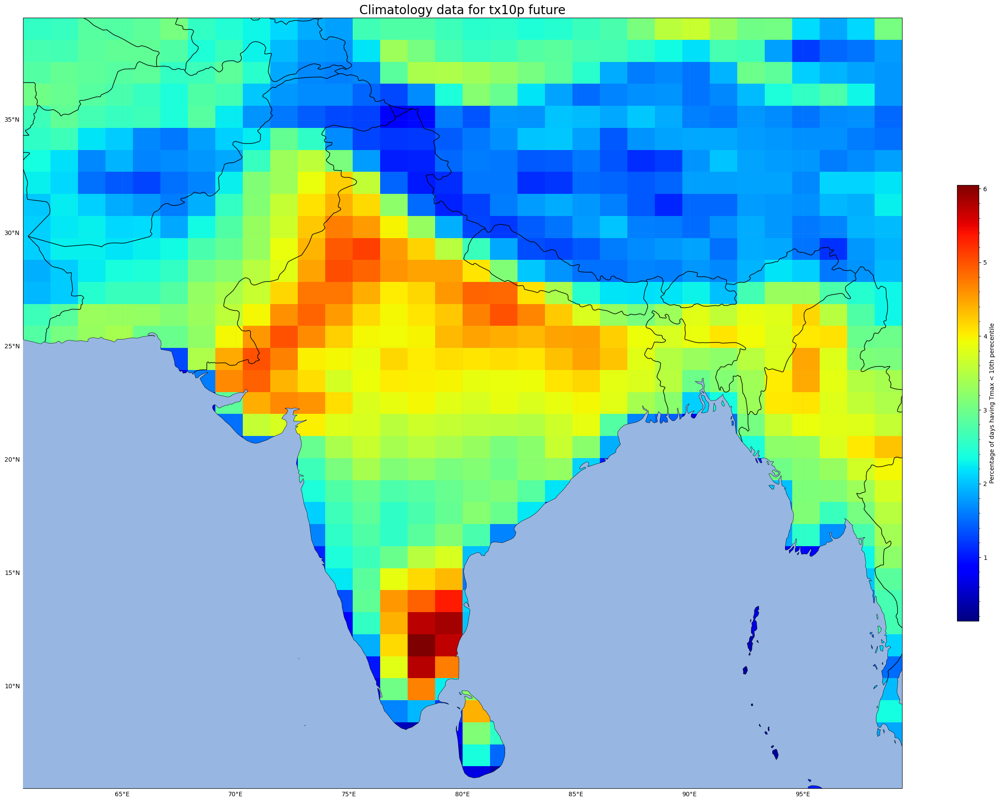

In [227]:
## climatology spatial plot 

# importing the important libraries 

import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# reading the data

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.mean(dim=['time'])
spatial_data = spatial_data.squeeze()

# plotting the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Climatology data for tx10p future', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
# ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder=100)


cbar = fig.colorbar(mp, shrink=0.4,label='Percentage of days having Tmax < 10th perecentile')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-future-spatial-climatology.png', dpi=600, bbox_inches='tight')
plt.show()


Trying to use the India Shapefile 

In [25]:
%pip install geopandas

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


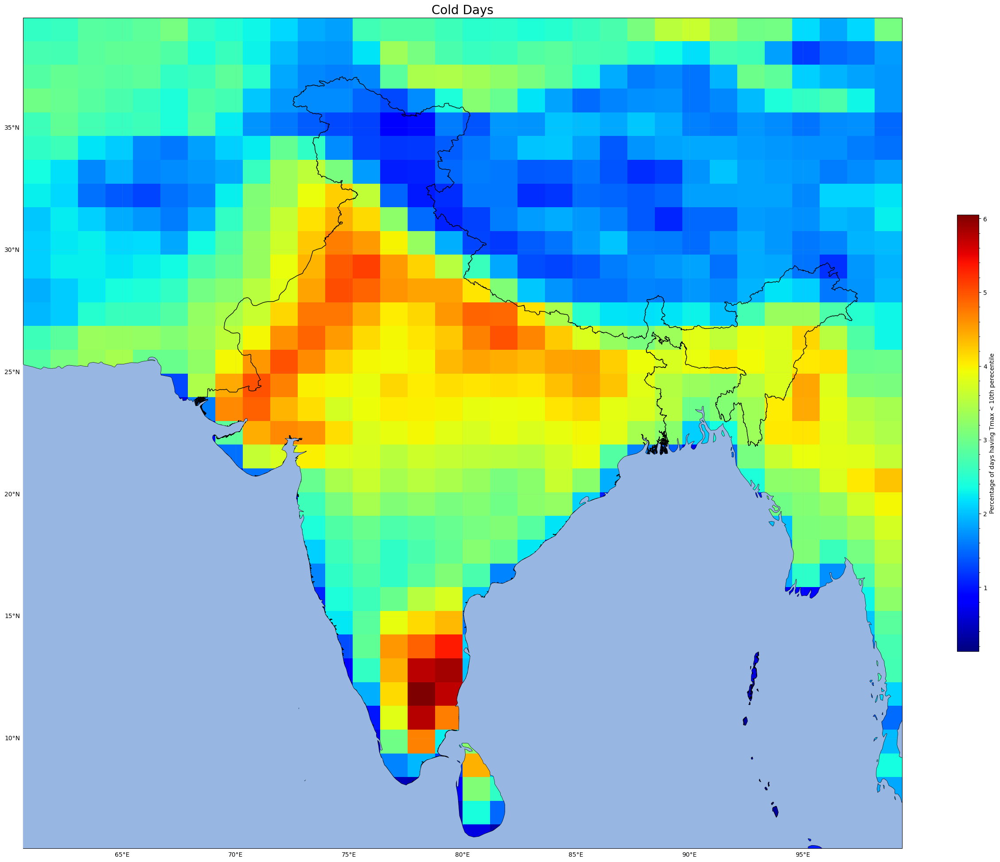

In [230]:
import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.mean(dim=['time'])
spatial_data = spatial_data.squeeze()

lat = spatial_data.lat
lon = spatial_data.lon

india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='jet', origin='lower')
plt.title('Cold Days', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder=100)

cbar = fig.colorbar(mp, shrink=0.4,label='Percentage of days having Tmax < 10th perecentile')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False


plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-future-spatial-shapefile-climatology.png', dpi=600, bbox_inches='tight')

plt.show()


everything outside india set to zero 

In [42]:
%pip install rasterio rioxarray


Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 40.2 MB/s eta 0:00:00m eta 0:00:010:01:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.5/53.5 KB 27.9 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


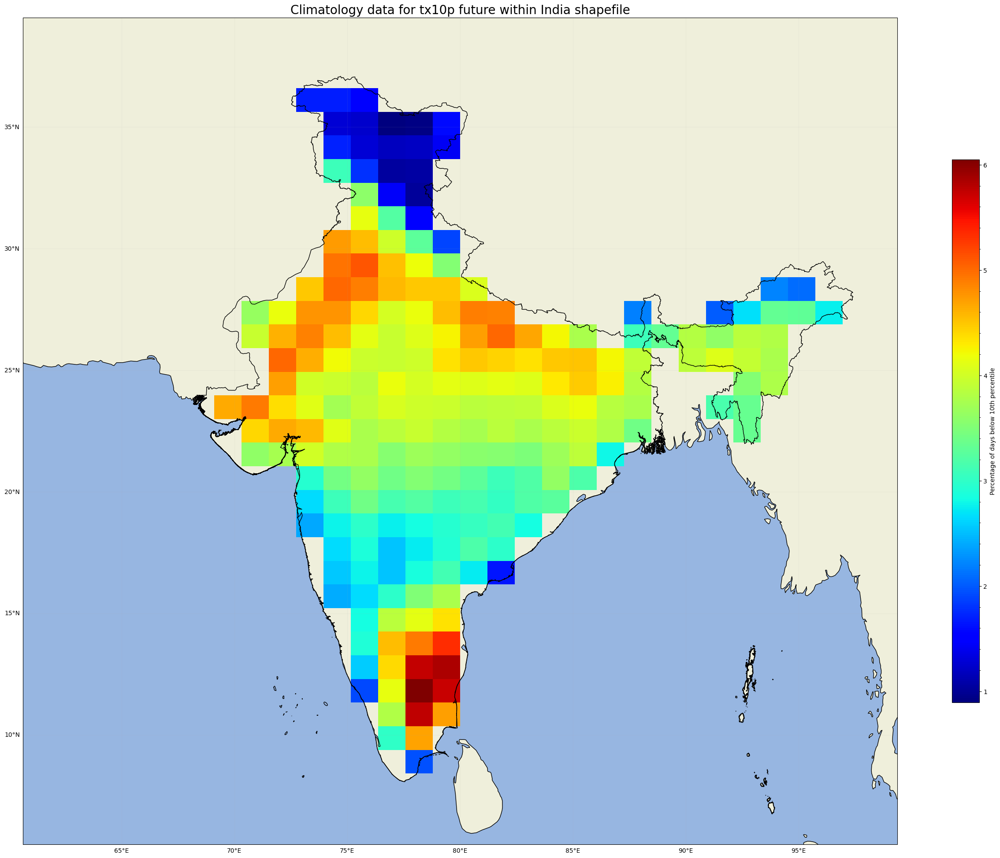

In [265]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import rasterio.features
import pyproj
from shapely.geometry import Point

def create_mask_from_shapefile(dataset, shapefile_gdf):
    lon, lat = np.meshgrid(dataset.lon.values, dataset.lat.values)
    
    # Get the MultiPolygon from the GeoDataFrame
    india_shape = shapefile_gdf.geometry.iloc[0]
    
    mask = np.zeros_like(dataset)

    for i, row in enumerate(lat):
        for j, col in enumerate(lon[0]):
            if india_shape.contains(Point(lon[i, j], lat[i, j])):
                mask[i, j] = 1

    return mask

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
spatial_data = spatial_data['tx10pETCCDI']
spatial_data = spatial_data.mean(dim=['time'])
spatial_data = spatial_data.squeeze()

lat = spatial_data.lat
lon = spatial_data.lon

india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

mask = create_mask_from_shapefile(spatial_data, india_gdf)
masked_data = spatial_data.where(mask == 1, np.nan)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(masked_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='jet', origin='lower')
plt.title('Climatology data for tx10p future within India shapefile', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)

cbar = fig.colorbar(mp, shrink=0.5, label='Percentage of days below 10th percentile')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-future-spatial-shapefile-nan-climatology.png', dpi=600, bbox_inches='tight')


plt.show()


Spatial trend data plot 

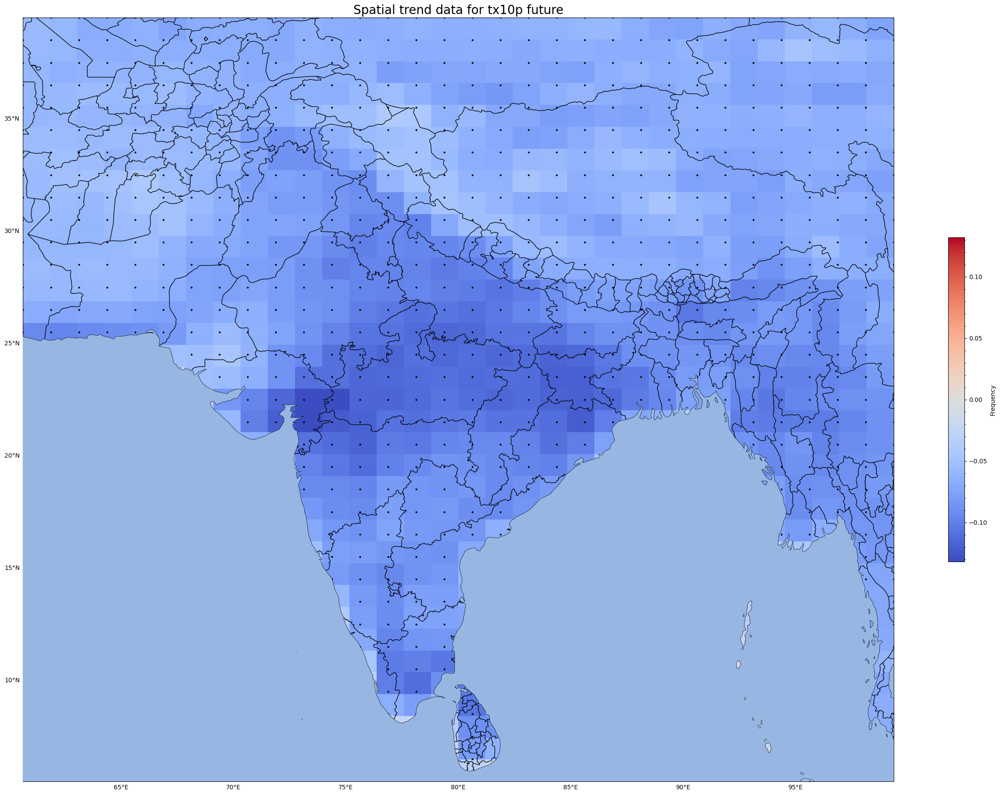

In [232]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)


fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))


mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


# Plot black dots at significant trend locations
for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        if significant_trends[lat_idx, lon_idx]:
            ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for tx10p future', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-future-spatial-trend.png', dpi=600, bbox_inches='tight')
plt.show()


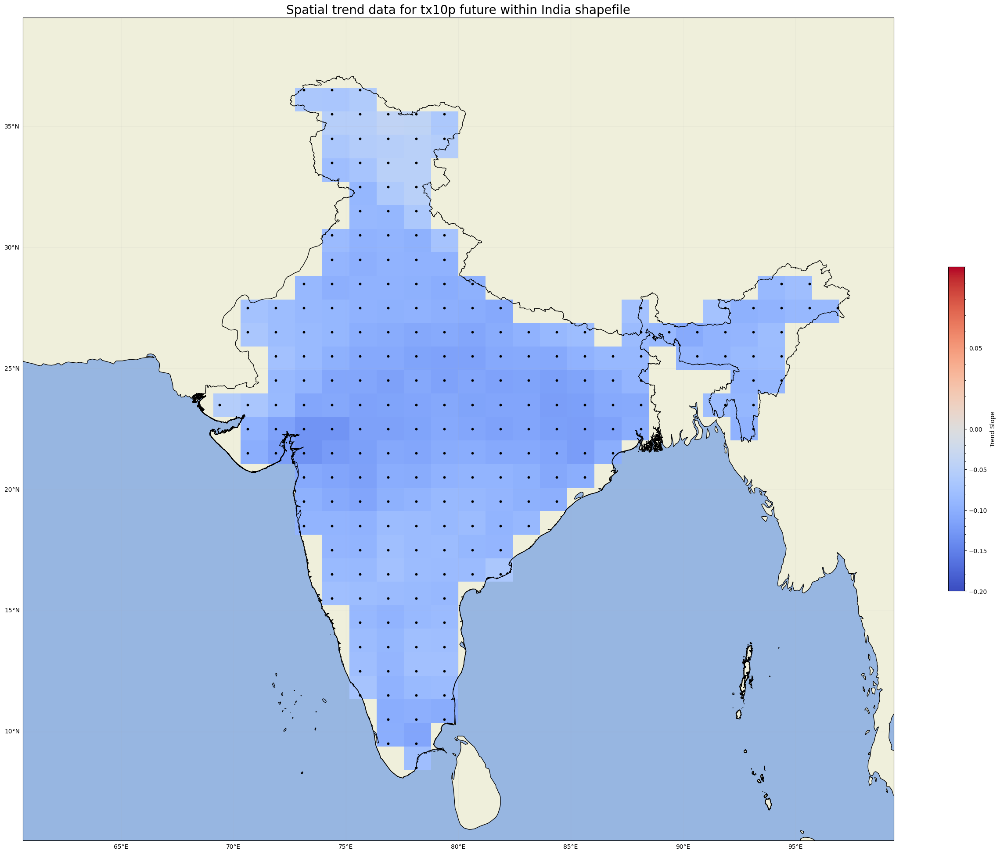

In [266]:
import netCDF4
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from matplotlib.colors import TwoSlopeNorm
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
from shapely.geometry import Point

# Read the NetCDF data and calculate trend and p_values
# (Same as the original code, no changes here)


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]


# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-0.20, vcenter=0, vmax=0.10)


# Read India boundary shapefile
india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)

def create_mask_from_shapefile(lon, lat, shapefile_gdf):
    lon_mesh, lat_mesh = np.meshgrid(lon, lat)
    india_shape = shapefile_gdf.geometry.iloc[0]
    mask = np.zeros_like(lat_mesh)

    for i, row in enumerate(lat_mesh):
        for j, col in enumerate(lon_mesh[0]):
            if india_shape.contains(Point(lon_mesh[i, j], lat_mesh[i, j])):
                mask[i, j] = 1

    return mask

# Create mask using the India shapefile
mask = create_mask_from_shapefile(lon, lat, india_gdf)
masked_trend = np.where(mask == 1, trend, np.nan)

# Rest of the plotting code remains the same

# Normalize the colorbar
max_abs_value = np.max(np.abs(masked_trend))
norm = TwoSlopeNorm(vmin=-0.20, vcenter=0, vmax=0.10)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)
plt.title('Spatial trend data for tx10p future within India shapefile', fontsize=20)

india_gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black', transform=ccrs.PlateCarree())

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN)

# Add black dots for significant trends (p < 0.05)
lon_mesh, lat_mesh = np.meshgrid(lon, lat)
significant_trend = np.where((mask == 1) & (p_values < 0.05))
ax.scatter(lon_mesh[significant_trend], lat_mesh[significant_trend], color='black', s=10, transform=ccrs.PlateCarree())


cbar = fig.colorbar(mp, shrink=0.3, label='Trend Slope')
cbar.minorticks_on()

gl = ax.gridlines(draw_labels=True, alpha=0.1)
gl.top_labels = False
gl.right_labels = False

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/spatial-trend-future-india-shapefile.png', dpi=600, bbox_inches='tight')
plt.show()


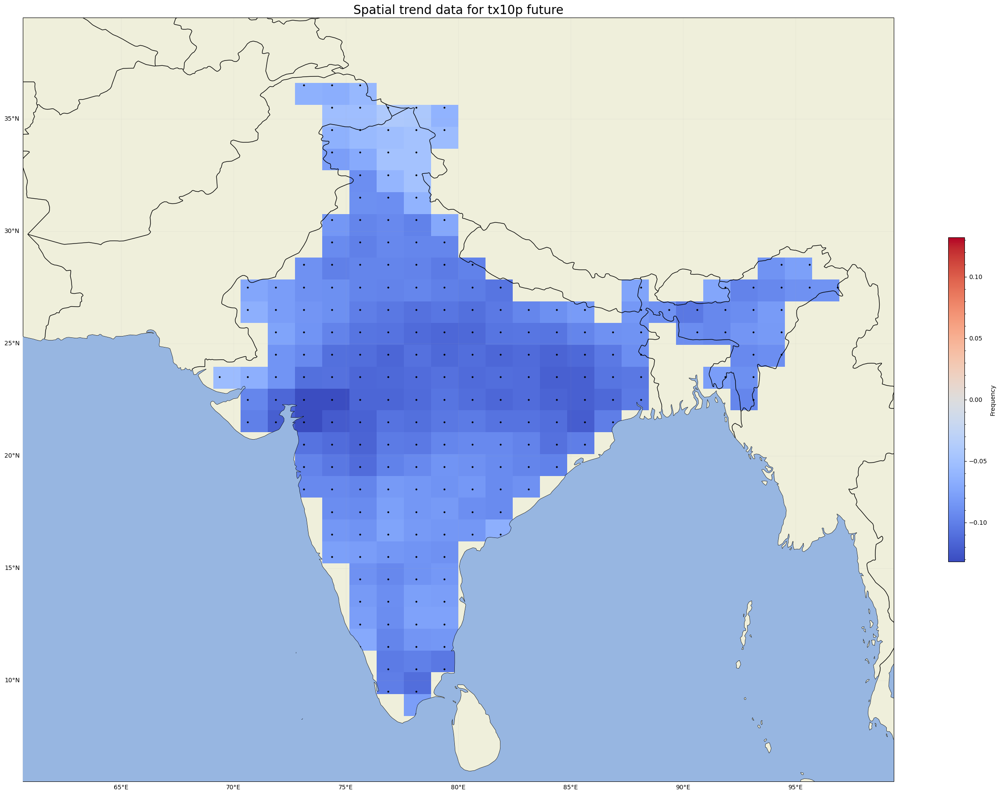

In [18]:
import netCDF4
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import scipy.stats as stats
from shapely.geometry import Point
from matplotlib.colors import TwoSlopeNorm

def create_mask_from_shapefile(dataset, shapefile_gdf):
    lon, lat = np.meshgrid(dataset.lon.values, dataset.lat.values)
    india_shape = shapefile_gdf.geometry.iloc[0]
    mask = np.zeros_like(dataset)

    for i, row in enumerate(lat):
        for j, col in enumerate(lon[0]):
            if india_shape.contains(Point(lon[i, j], lat[i, j])):
                mask[i, j] = 1

    return mask

nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')

tx10p = nc.variables['tx10pETCCDI'][:] 
time_dim, lat_dim, lon_dim = tx10p.shape

trend = np.zeros((lat_dim, lon_dim))
p_values = np.zeros((lat_dim, lon_dim))

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        data = tx10p[:, lat_idx, lon_idx]
        slope, intercept, r_value, p_value, std_error = stats.linregress(np.arange(time_dim), data)
        trend[lat_idx, lon_idx] = slope
        p_values[lat_idx, lon_idx] = p_value

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)

# Apply the mask
india_shapefile_path = '/home/shiv/Documents/GitHub/EES405/assignment_4/India_Boundary_shapefile/India_Boundary.shp'
india_gdf = gpd.read_file(india_shapefile_path)
spatial_data = xr.DataArray(trend, coords=[lat, lon], dims=['lat', 'lon'])
mask = create_mask_from_shapefile(spatial_data, india_gdf)
masked_trend = spatial_data.where(mask == 1, np.nan)

masked_significant_trends = xr.DataArray(significant_trends, coords=[lat, lon], dims=['lat', 'lon']).where(mask == 1, False)

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))

mp = ax.imshow(masked_trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        if masked_significant_trends[lat_idx, lon_idx]:
            ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for tx10p future', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS, edgecolor='black')
# ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


In [27]:
%pip install pymannkendall

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


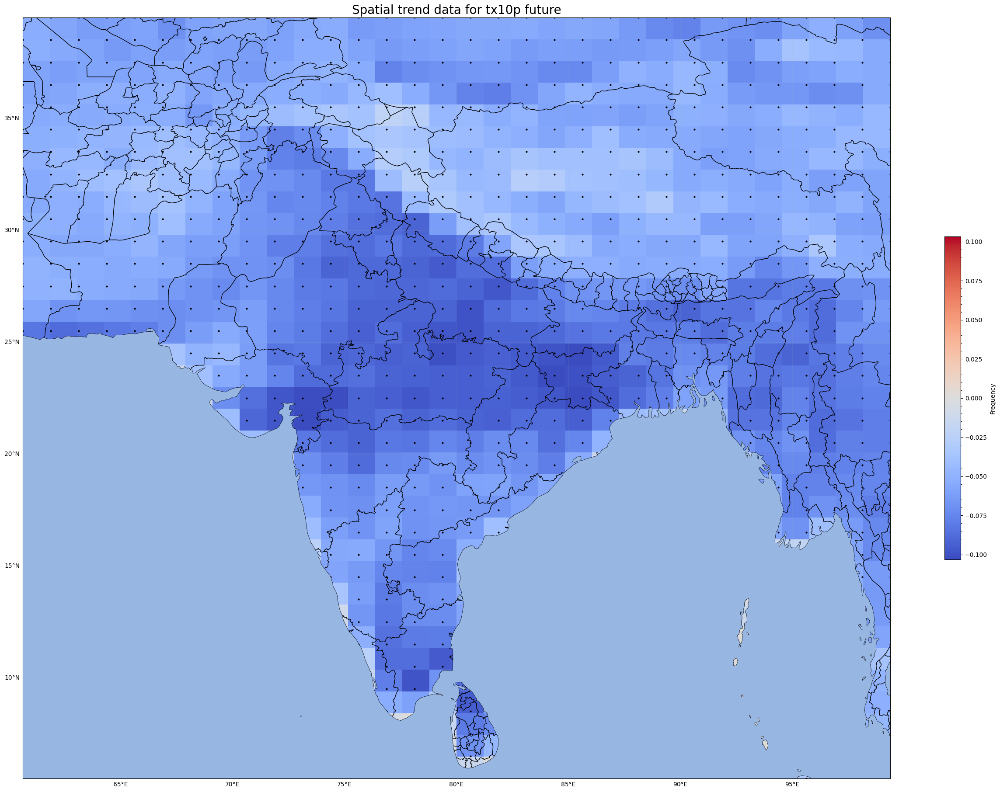

In [28]:
## trying to do mann-kendall test for the trends 
import netCDF4
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy import stats


from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')

# extract the dataset for tx10pETCCDI

tx10p = nc.variables['tx10pETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

import pymannkendall as mk

# Replace the following section of your code
for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # Perform the Mann-Kendall test
        result = mk.original_test(data)
        
        # Append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = result.slope
        p_values[lat_idx,lon_idx] = result.p

        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)


fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))


mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


# Plot black dots at significant trend locations
for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        if significant_trends[lat_idx, lon_idx]:
            ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for tx10p future', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


Timeseries data plot for various regions of India 

/tmp/ipykernel_124115/845732095.py:20: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_north_india_future_fldmean['time'] = tx10p_north_india_future_fldmean.indexes['time'].to_datetimeindex()


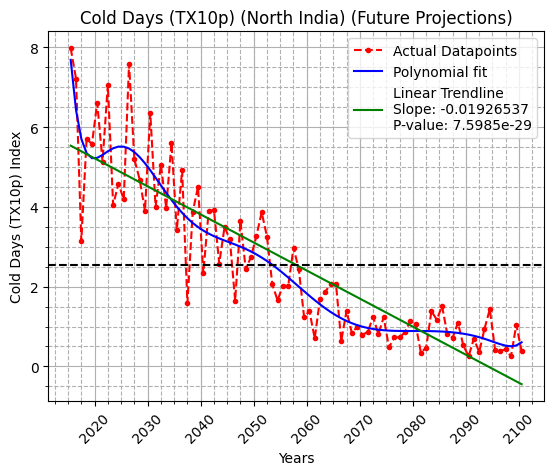

In [233]:
## North India 

# Timeseries for north India

tx10p_north_india_future = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.future.north_india.nc')
tx10p_north_india_future = tx10p_north_india_future['tx10pETCCDI']
tx10p_north_india_future

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_north_india_future_fldmean = tx10p_north_india_future.mean(dim=['lat','lon'])
tx10p_north_india_future_fldmean

import pandas as pd
data_mean = tx10p_north_india_future_fldmean.mean().item()
data_std = tx10p_north_india_future_fldmean.std().item()

x = date2num(tx10p_north_india_future_fldmean['time'].values)

tx10p_north_india_future_fldmean['time'] = tx10p_north_india_future_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_north_india_future_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_north_india_future_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_north_india_future_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_north_india_future_fldmean['time'], tx10p_north_india_future_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_north_india_future_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_north_india_future_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_north_india_future_fldmean['time'], [max_height]*len(tx10p_north_india_future_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (North India) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.north_india_fut.png',dpi=600, bbox_inches='tight')

plt.show()


/tmp/ipykernel_124115/1642592834.py:20: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_central_india_future_fldmean['time'] = tx10p_central_india_future_fldmean.indexes['time'].to_datetimeindex()


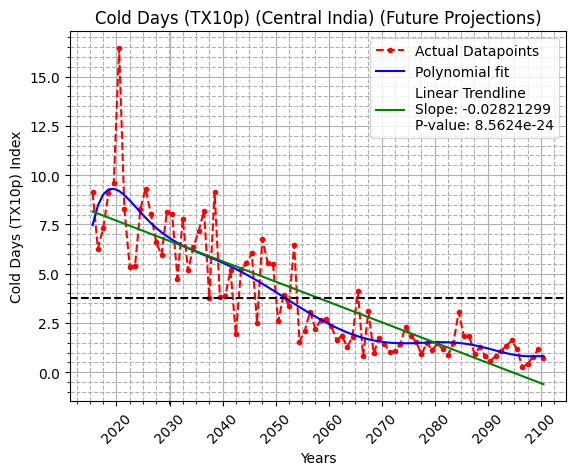

In [234]:
## Central India 

# Timeseries for central India

tx10p_central_india_future = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.future.central_india.nc')
tx10p_central_india_future = tx10p_central_india_future['tx10pETCCDI']
tx10p_central_india_future

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_central_india_future_fldmean = tx10p_central_india_future.mean(dim=['lat','lon'])
tx10p_central_india_future_fldmean

import pandas as pd
data_mean = tx10p_central_india_future_fldmean.mean().item()
data_std = tx10p_central_india_future_fldmean.std().item()

x = date2num(tx10p_central_india_future_fldmean['time'].values)

tx10p_central_india_future_fldmean['time'] = tx10p_central_india_future_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_central_india_future_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_central_india_future_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_central_india_future_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_central_india_future_fldmean['time'], tx10p_central_india_future_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_central_india_future_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_central_india_future_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_central_india_future_fldmean['time'], [max_height]*len(tx10p_central_india_future_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (Central India) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')

plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.central_india_fut.png',dpi=600, bbox_inches='tight')

plt.show()


/tmp/ipykernel_124115/1842681394.py:20: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_west_india_future_fldmean['time'] = tx10p_west_india_future_fldmean.indexes['time'].to_datetimeindex()


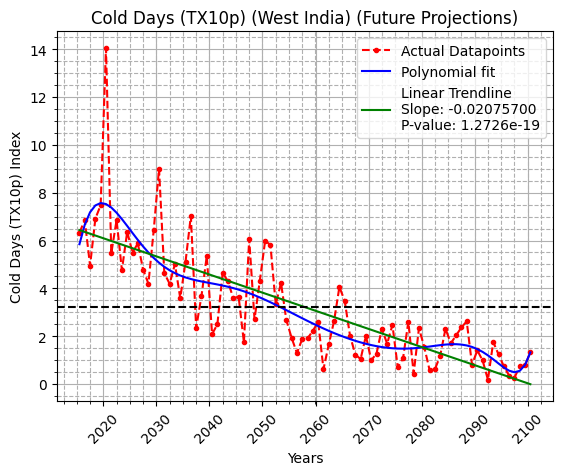

In [235]:
## West India 

# Timeseries for west India

tx10p_west_india_future = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.future.west_india.nc')
tx10p_west_india_future = tx10p_west_india_future['tx10pETCCDI']
tx10p_west_india_future

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_west_india_future_fldmean = tx10p_west_india_future.mean(dim=['lat','lon'])
tx10p_west_india_future_fldmean

import pandas as pd
data_mean = tx10p_west_india_future_fldmean.mean().item()
data_std = tx10p_west_india_future_fldmean.std().item()

x = date2num(tx10p_west_india_future_fldmean['time'].values)

tx10p_west_india_future_fldmean['time'] = tx10p_west_india_future_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_west_india_future_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_west_india_future_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_west_india_future_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_west_india_future_fldmean['time'], tx10p_west_india_future_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_west_india_future_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_west_india_future_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_west_india_future_fldmean['time'], [max_height]*len(tx10p_west_india_future_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (West India) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.west_india_fut.png',dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/64900808.py:20: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_east_india_future_fldmean['time'] = tx10p_east_india_future_fldmean.indexes['time'].to_datetimeindex()


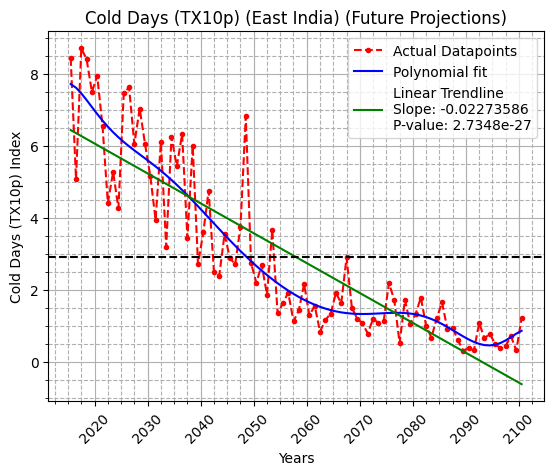

In [236]:
## East India 

# Timeseries for east India

tx10p_east_india_future = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.future.east_india.nc')
tx10p_east_india_future = tx10p_east_india_future['tx10pETCCDI']
tx10p_east_india_future

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_east_india_future_fldmean = tx10p_east_india_future.mean(dim=['lat','lon'])
tx10p_east_india_future_fldmean

import pandas as pd
data_mean = tx10p_east_india_future_fldmean.mean().item()
data_std = tx10p_east_india_future_fldmean.std().item()

x = date2num(tx10p_east_india_future_fldmean['time'].values)

tx10p_east_india_future_fldmean['time'] = tx10p_east_india_future_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_east_india_future_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_east_india_future_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_east_india_future_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_east_india_future_fldmean['time'], tx10p_east_india_future_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_east_india_future_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_east_india_future_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_east_india_future_fldmean['time'], [max_height]*len(tx10p_east_india_future_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (East India) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.east_india_fut.png',dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/371892554.py:20: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_south_india_future_fldmean['time'] = tx10p_south_india_future_fldmean.indexes['time'].to_datetimeindex()


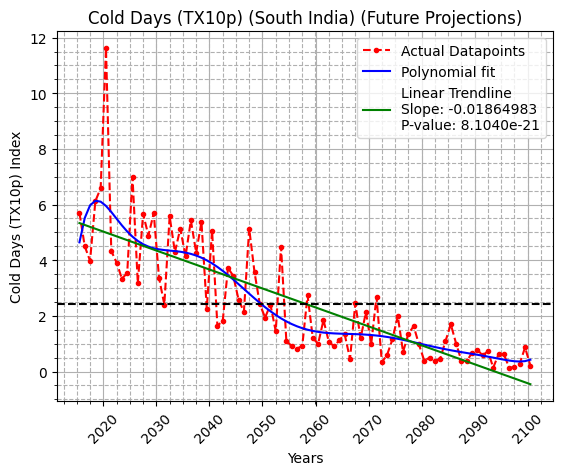

In [237]:
## South India 

# Timeseries for south India

tx10p_south_india_future = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.future.south_india.nc')
tx10p_south_india_future = tx10p_south_india_future['tx10pETCCDI']
tx10p_south_india_future

## taking mean along the lat and lon axis so that I am only left with timeseries data 

tx10p_south_india_future_fldmean = tx10p_south_india_future.mean(dim=['lat','lon'])
tx10p_south_india_future_fldmean

import pandas as pd
data_mean = tx10p_south_india_future_fldmean.mean().item()
data_std = tx10p_south_india_future_fldmean.std().item()

x = date2num(tx10p_south_india_future_fldmean['time'].values)

tx10p_south_india_future_fldmean['time'] = tx10p_south_india_future_fldmean.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_south_india_future_fldmean, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_south_india_future_fldmean.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_south_india_future_fldmean)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_south_india_future_fldmean['time'], tx10p_south_india_future_fldmean, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_south_india_future_fldmean['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_south_india_future_fldmean['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_south_india_future_fldmean['time'], [max_height]*len(tx10p_south_india_future_fldmean), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (South India) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.south_india_fut.png',dpi=600, bbox_inches='tight')
plt.show()


Find out the trend (time series from 1851-2100) of given index at Delhi (28° N latitude to 77° E longitude), Mumbai (8° N latitude - 72°E longitude), Kolkata (22°N latitude and 88° E longitude).  Add p-value to understand the significance.

/tmp/ipykernel_124115/202944989.py:16: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_delhi['time'] = tx10p_delhi.indexes['time'].to_datetimeindex()


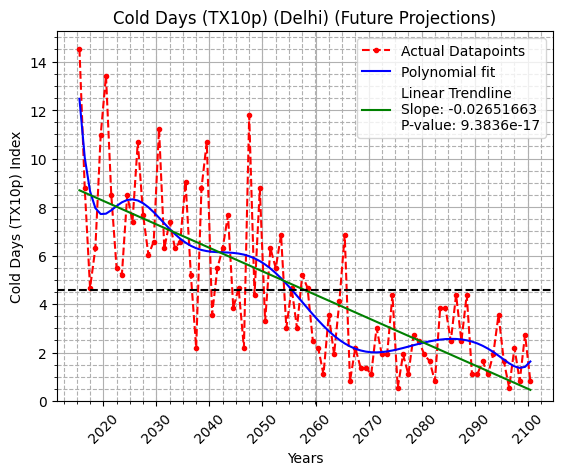

In [238]:
## tx10p trend for delhi 

tx10p_delhi = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
tx10p_delhi = tx10p_delhi['tx10pETCCDI']

# select a particular latitude and longitude for delhi 
tx10p_delhi = tx10p_delhi.sel(lat=28.7041,lon=77.1025,method='nearest')


import pandas as pd
data_mean = tx10p_delhi.mean().item()
data_std = tx10p_delhi.std().item()

x = date2num(tx10p_delhi['time'].values)

tx10p_delhi['time'] = tx10p_delhi.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_delhi, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_delhi.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_delhi)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_delhi['time'], tx10p_delhi, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_delhi['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_delhi['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_delhi['time'], [max_height]*len(tx10p_delhi), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (Delhi) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.delhi_fut.png',dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/2753386699.py:15: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_mumbai['time'] = tx10p_mumbai.indexes['time'].to_datetimeindex()


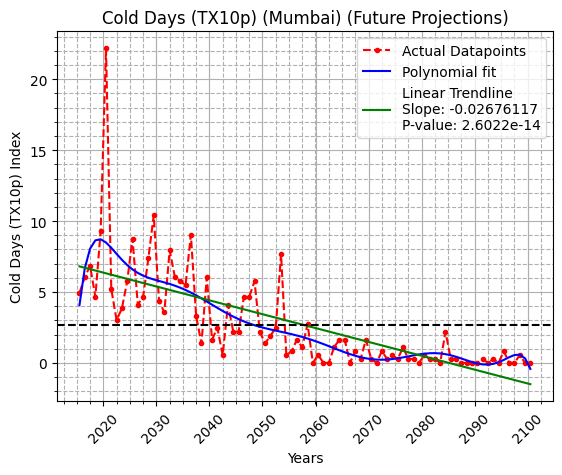

In [239]:
## tx10p trend for Mumbai 

tx10p_mumbai = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
tx10p_mumbai = tx10p_mumbai['tx10pETCCDI']

# select a particular latitude and longitude for mumbai
tx10p_mumbai = tx10p_mumbai.sel(lat=19.0760,lon=72.8777,method='nearest')

import pandas as pd
data_mean = tx10p_mumbai.mean().item()
data_std = tx10p_mumbai.std().item()

x = date2num(tx10p_mumbai['time'].values)

tx10p_mumbai['time'] = tx10p_mumbai.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_mumbai, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_mumbai.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_mumbai)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_mumbai['time'], tx10p_mumbai, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_mumbai['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_mumbai['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_mumbai['time'], [max_height]*len(tx10p_mumbai), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (Mumbai) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.mumbai_fut.png',dpi=600, bbox_inches='tight')
plt.show()


/tmp/ipykernel_124115/1395463053.py:15: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  tx10p_kolkata['time'] = tx10p_kolkata.indexes['time'].to_datetimeindex()


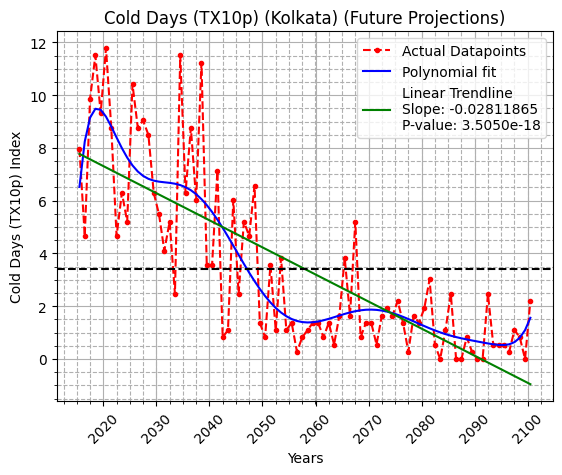

In [240]:
## tx10p trend for Mumbai 

tx10p_kolkata = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/tx10p.india.future.nc')
tx10p_kolkata = tx10p_kolkata['tx10pETCCDI']

# select a particular latitude and longitude for kolkata
tx10p_kolkata = tx10p_kolkata.sel(lat=22.5726,lon=88.3639,method='nearest')

import pandas as pd
data_mean = tx10p_kolkata.mean().item()
data_std = tx10p_kolkata.std().item()

x = date2num(tx10p_kolkata['time'].values)

tx10p_kolkata['time'] = tx10p_kolkata.indexes['time'].to_datetimeindex()

# Fit a 20-degree polynomial curve to the filtered data
p = np.polyfit(x, tx10p_kolkata, 10)

# Evaluate the curve at each data point
trendline = np.polyval(p, x)

# Plot the actual data points with a red dashed line, trendline with a blue solid line, and bars with height equal to the maximum of the filtered data
max_height = tx10p_kolkata.max()
from scipy.stats import linregress

# Fit a linear trend to the original data
slope, intercept, r_value, p_value, std_err = linregress(x, tx10p_kolkata)

# Evaluate the linear trendline at each data point
linear_trendline = slope * x + intercept

fig, ax = plt.subplots()

ax.plot(tx10p_kolkata['time'], tx10p_kolkata, 'r.--', label='Actual Datapoints')
ax.plot(tx10p_kolkata['time'], trendline, 'b-', label=f'Polynomial fit')
ax.plot(tx10p_kolkata['time'], linear_trendline, 'g-', label=f'Linear Trendline\nSlope: {slope*100:.8f}\nP-value: {p_value:.4e}')
ax.axhline(y=data_mean, color='black', linestyle='--')
ax.bar(tx10p_kolkata['time'], [max_height]*len(tx10p_kolkata), alpha=0.3, width=1)

ax.set_xlabel('Years')
ax.set_ylabel('Cold Days (TX10p) Index')
ax.set_title('Cold Days (TX10p) (Kolkata) (Future Projections)')
ax.legend()
# Set the x-axis tick labels to be rotated 45 degrees for better readability and add minor gridlines
plt.xticks(rotation=45)
plt.grid(True)
plt.minorticks_on()
plt.grid(which='minor', linestyle='--')
plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p.kolkata_fut.png',dpi=600, bbox_inches='tight')
plt.show()


### CWD

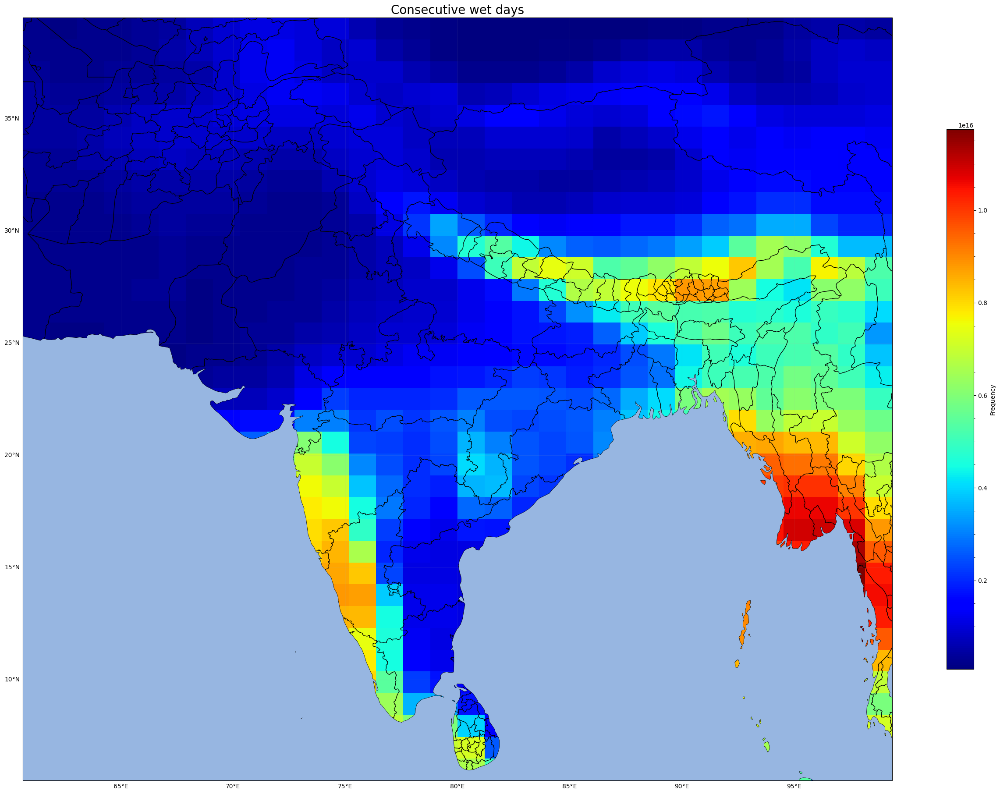

In [22]:
## climatology spatial plot 

# importing the important libraries 

import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# reading the data

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/cwd.timmean.historical.nc').squeeze()
spatial_data = spatial_data['cwdETCCDI']
# Convert timedelta64[ns] to the number of days (float)
spatial_data = spatial_data.astype('timedelta64[D]').astype(float)

# spatial_data = spatial_data.mean(dim='time')

# plotting the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Consecutive wet days', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder=100)


cbar = fig.colorbar(mp, shrink=0.5,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology.png', dpi=600, bbox_inches='tight')
plt.show()


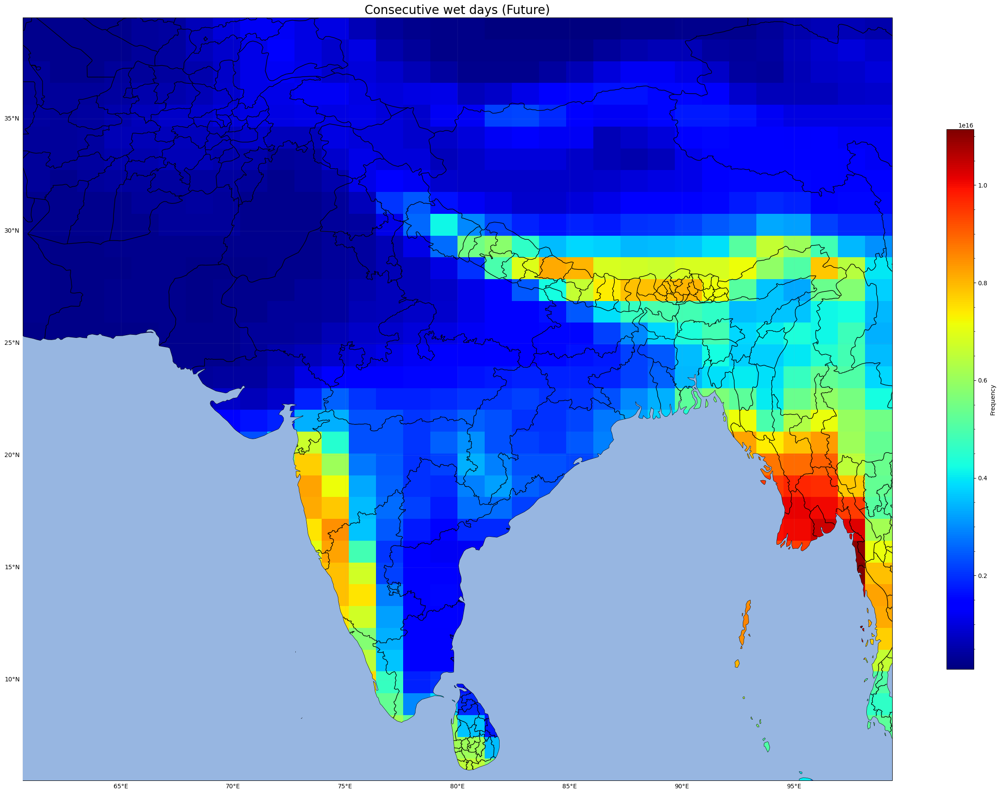

In [251]:
## climatology spatial plot 

# importing the important libraries 

import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# reading the data

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/cwd.india.timmean.nc').squeeze()
spatial_data = spatial_data['cwdETCCDI']
# Convert timedelta64[ns] to the number of days (float)
spatial_data = spatial_data.astype('timedelta64[D]').astype(float)

# spatial_data = spatial_data.mean(dim='time')

# plotting the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Consecutive wet days (Future)', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder=100)


cbar = fig.colorbar(mp, shrink=0.5,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology.png', dpi=600, bbox_inches='tight')
plt.show()


spatial trend data using linear regression model 


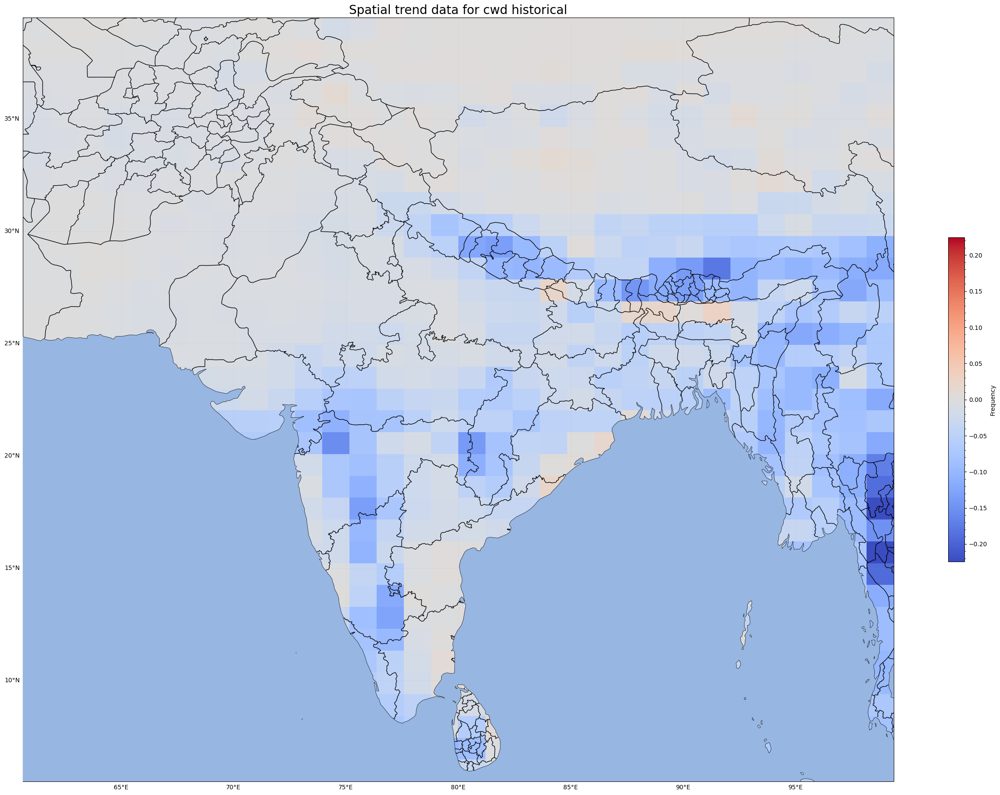

In [21]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/cwd.india.historical.nc')

# extract the dataset for cwdETCCDI

tx10p = nc.variables['cwdETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)


fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))


mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


# # Plot black dots at significant trend locations
# for lat_idx in range(lat_dim):
#     for lon_idx in range(lon_dim):
#         if significant_trends[lat_idx, lon_idx]:
#             ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for cwd historical', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


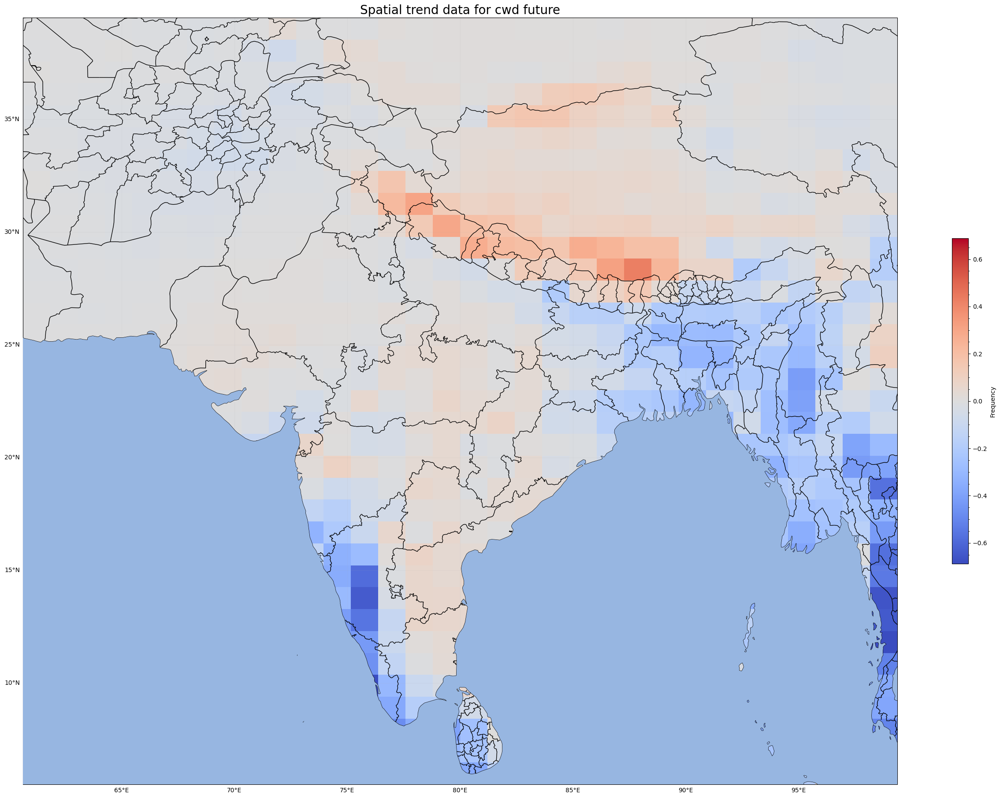

In [252]:
from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/cwd.future.india.nc')

# extract the dataset for cwdETCCDI

tx10p = nc.variables['cwdETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)


fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))


mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


# # Plot black dots at significant trend locations
# for lat_idx in range(lat_dim):
#     for lon_idx in range(lon_dim):
#         if significant_trends[lat_idx, lon_idx]:
#             ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for cwd future', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


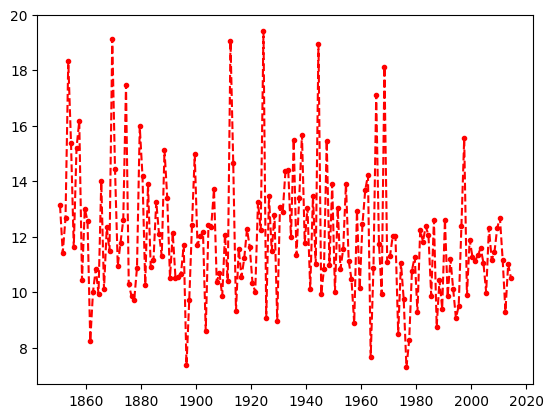

In [73]:
## tx10p trend for Mumbai 
cwd_north = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/north.time.nc').squeeze()
cwd_north 

plt.plot(cwd_north.time, cwd_north.cwdetccdi,'r.--')
plt.show()

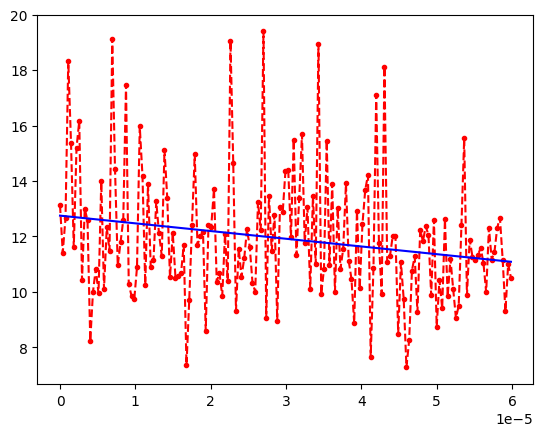

Slope of the trendline: -3.2166654998963136e-19


In [92]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

cwd_north = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/north.time.nc').squeeze()

# Convert time to a numerical form (number of days since the first date)
time_num = (cwd_north.time - cwd_north.time[0]).astype('timedelta64[D]').astype(float)

# Plot the data
plt.plot(time_num/8.64e22, cwd_north.cwdetccdi, 'r.--')

# Fit a linear regression line to the data
slope, intercept = np.polyfit(time_num, cwd_north.cwdetccdi, 1)

# Calculate the line values for the plot
trendline = slope * time_num + intercept

# Add the trendline to the plot
plt.plot(time_num/8.64e22, trendline, 'b-')

# Show the plot
plt.show()

# Print the slope value
print(f"Slope of the trendline: {slope}")


In [78]:
## error data 

data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/cwd.historical.north_india.nc')
data = data['cwdETCCDI']
data

<xarray.DataArray 'cwdETCCDI' (time: 165, lat: 8, lon: 6)>
[7920 values with dtype=timedelta64[ns]]
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00
  * lon      (lon) float64 73.12 74.38 75.62 76.88 78.12 79.38
  * lat      (lat) float64 29.5 30.5 31.5 32.5 33.5 34.5 35.5 36.5
Attributes:
    long_name:      Maximum Number of Consecutive Days with At Least 1mm of P...
    cell_methods:   area: mean time: maximum
    cell_measures:  area: areacella
    interp_method:  conserve_order2
    original_name:  tasmax
    history:        Created by climdex.pcic 1.1.9.1 on Mon Jul  8 09:01:09 2019

In [79]:
data = data.mean(dim=['lat','lon'])
data

<xarray.DataArray 'cwdETCCDI' (time: 165)>
array([1126800000000000,  988200000000000, 1098000000000000,
       1567800000000000, 1330200000000000, 1000800000000000,
       1299600000000000, 1389600000000000,  901800000000000,
       1119600000000000, 1083600000000000,  714600000000000,
        865800000000000,  934200000000000,  855000000000000,
       1206000000000000,  874800000000000, 1060200000000000,
        995400000000000, 1643400000000000, 1247400000000000,
        946800000000000, 1013400000000000, 1080000000000000,
       1503000000000000,  892800000000000,  856800000000000,
        844200000000000,  939600000000000, 1366200000000000,
       1213200000000000,  885600000000000, 1195200000000000,
        936000000000000,  959400000000000, 1144800000000000,
       1044000000000000,  975600000000000, 1301400000000000,
       1148400000000000,  907200000000000, 1051200000000000,
        905400000000000,  910800000000000,  923400000000000,
       1008000000000000,  639000000000000,  838800000000000,
       1065600000000000, 1294200000000000, 1008000000000000,
       1031400000000000, 1045800000000000,  745200000000000,
       1071000000000000, 1065600000000000, 1182600000000000,
        898200000000000,  923400000000000,  851400000000000,
...
       1110600000000000,  876600000000000, 1074600000000000,
       1175400000000000, 1222200000000000,  667800000000000,
        936000000000000, 1468800000000000, 1022400000000000,
        862200000000000, 1558800000000000,  954000000000000,
        977400000000000, 1040400000000000, 1036800000000000,
        739800000000000,  954000000000000,  840600000000000,
        631800000000000,  718200000000000,  930600000000000,
        979200000000000,  801000000000000, 1054800000000000,
       1022400000000000, 1063800000000000, 1040400000000000,
        856800000000000, 1089000000000000,  759600000000000,
        907200000000000,  815400000000000, 1087200000000000,
        851400000000000,  975600000000000,  871200000000000,
        783000000000000,  820800000000000, 1071000000000000,
       1333800000000000,  855000000000000, 1024200000000000,
        975600000000000,  955800000000000,  972000000000000,
        997200000000000,  955800000000000,  860400000000000,
       1058400000000000,  964800000000000,  982800000000000,
       1060200000000000, 1096200000000000,  970200000000000,
        802800000000000,  957600000000000,  912600000000000],
      dtype='timedelta64[ns]')
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00

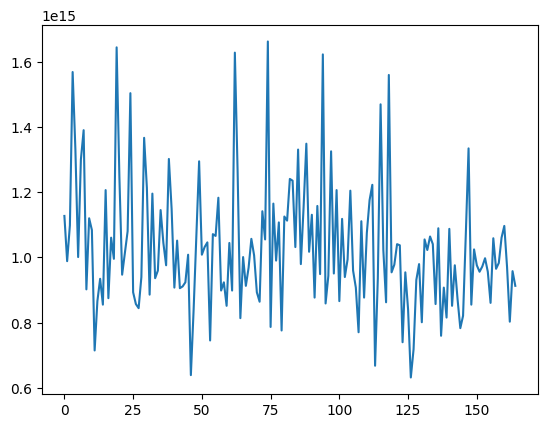

In [81]:
plt.plot(data)

### gsl 

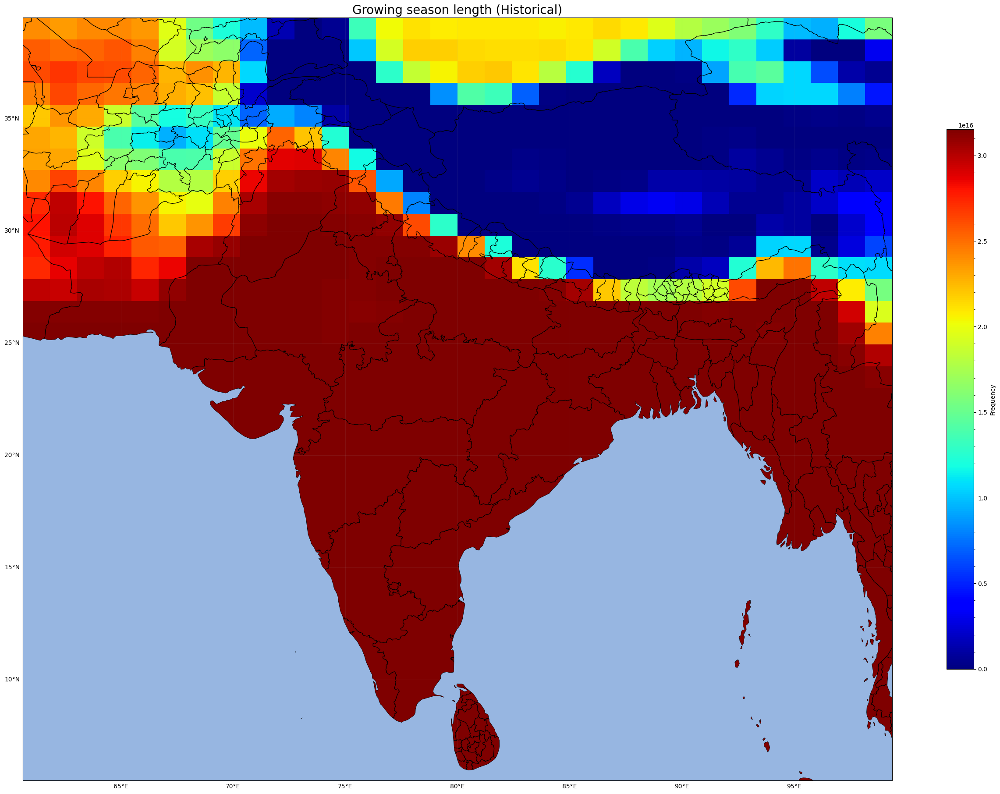

In [185]:
## climatology spatial plot 

# importing the important libraries 

import xarray as xr
import numpy as np 
import matplotlib.pyplot as plt 
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# reading the data

spatial_data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/gsl.timmean.historical.nc').squeeze()
spatial_data = spatial_data['gslETCCDI']
# Convert timedelta64[ns] to the number of days (float)
spatial_data = spatial_data.astype('timedelta64[D]').astype(float)

# spatial_data = spatial_data.mean(dim='time')

# plotting the data
lat = spatial_data.lat
lon = spatial_data.lon

fig = plt.figure(figsize = (32,32))
ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0.0, globe = None))

mp = ax.imshow(spatial_data, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap = 'jet', origin='lower')
plt.title('Growing season length (Historical)', fontsize = 20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN,zorder=100)


cbar = fig.colorbar(mp, shrink=0.5,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('/home/shiv/Documents/GitHub/EES405/assignment_4/plots/tx10p-historical-spatial-climatology.png', dpi=600, bbox_inches='tight')
plt.show()


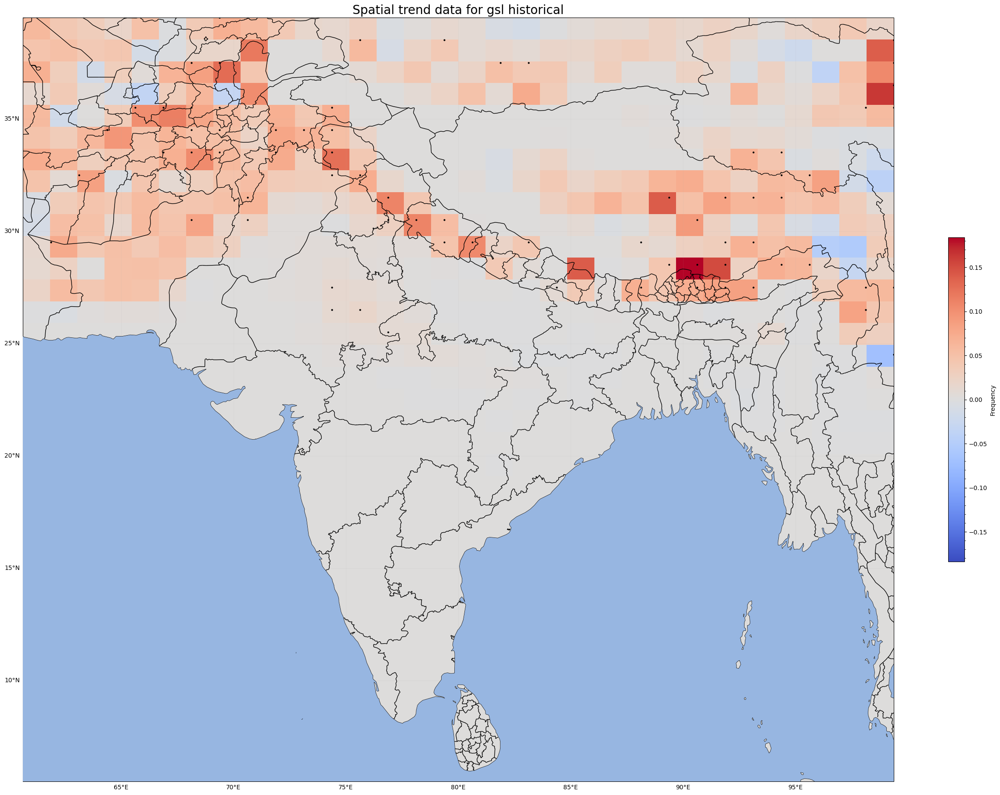

In [82]:
## spatial trend 

from matplotlib.colors import TwoSlopeNorm


nc = netCDF4.Dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/gsl.india.historical.nc')

# extract the dataset for cwdETCCDI

tx10p = nc.variables['gslETCCDI'][:] 

# dimensions of the data
time_dim,lat_dim,lon_dim = tx10p.shape

# arrays to store the trend and p-values
trend = np.zeros((lat_dim,lon_dim))
p_values = np.zeros((lat_dim,lon_dim))

# loop over each grid point 

for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        
        # calculate data at each grid point
        data = tx10p[:,lat_idx,lon_idx]
        
        # fit a linear regression model to the data
        slope,intercept,r_value,p_value,std_error = stats.linregress(np.arange(time_dim),data)
        
        # append the slope (trend) and p-values in the arrays
        trend[lat_idx,lon_idx] = slope
        p_values[lat_idx,lon_idx] = p_value
        
# visualising the trend using a heatmap or contour 

lat = nc.variables['lat'][:]
lon = nc.variables['lon'][:]

significant_trends = p_values < 0.05

# Normalize the colorbar
max_abs_value = np.max(np.abs(trend))
norm = TwoSlopeNorm(vmin=-max_abs_value, vcenter=0, vmax=max_abs_value)


fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree(central_longitude=0.0, globe=None))


mp = ax.imshow(trend, extent=(lon.min(), lon.max(), lat.min(), lat.max()), cmap='coolwarm', origin='lower', norm=norm)


# # Plot black dots at significant trend locations
for lat_idx in range(lat_dim):
    for lon_idx in range(lon_dim):
        if significant_trends[lat_idx, lon_idx]:
            ax.plot(lon[lon_idx], lat[lat_idx], 'ko', markersize=2, transform=ccrs.PlateCarree())

plt.title('Spatial trend data for gsl historical', fontsize=20)

states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
ax.add_feature(cfeature.BORDERS,edgecolor='black')
ax.add_feature(states_provinces, edgecolor='black')

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.OCEAN, zorder = 100)


cbar = fig.colorbar(mp, shrink=0.3,label='Frequency')
cbar.minorticks_on()

#adding the long lat grids and enabling the tick labels
gl = ax.gridlines(draw_labels=True,alpha=0.1)
gl.top_labels = False
gl.right_labels = False

# plt.savefig('historical-spatial-climatology.png', dpi=1200, bbox_inches='tight')
plt.show()


In [85]:
## gsl 

data = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/gsl.north_india.historical.nc')
data = data['gslETCCDI']
data

<xarray.DataArray 'gslETCCDI' (time: 165, lat: 8, lon: 6)>
[7920 values with dtype=timedelta64[ns]]
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00
  * lon      (lon) float64 73.12 74.38 75.62 76.88 78.12 79.38
  * lat      (lat) float64 29.5 30.5 31.5 32.5 33.5 34.5 35.5 36.5
Attributes:
    long_name:      Growing Season Length
    cell_methods:   area: mean time: maximum
    cell_measures:  area: areacella
    interp_method:  conserve_order2
    original_name:  tasmax
    history:        Created by climdex.pcic 1.1.9.1 on Mon Jul  8 09:01:09 2019

In [86]:
data_mean  = data.mean(dim=['lat','lon'])
data_mean

<xarray.DataArray 'gslETCCDI' (time: 165)>
array([14396400000000000, 14560200000000000, 14464800000000000,
       14434200000000000, 14272200000000000, 14668200000000000,
       14353200000000000, 14187600000000000, 14446800000000000,
       14065200000000000, 14617800000000000, 14522400000000000,
       14014800000000000, 14511600000000000, 13935600000000000,
       14461200000000000, 14868000000000000, 14844600000000000,
       14545800000000000, 14313600000000000, 14812200000000000,
       14072400000000000, 14261400000000000, 14491800000000000,
       14002200000000000, 14085000000000000, 14281200000000000,
       14333400000000000, 14437800000000000, 14680800000000000,
       14466600000000000, 14272200000000000, 14398200000000000,
       14718600000000000, 13383000000000000, 13989600000000000,
       14040000000000000, 14356800000000000, 14191200000000000,
       14513400000000000, 14567400000000000, 14502600000000000,
       14259600000000000, 14342400000000000, 14286600000000000,
       14599800000000000, 14016600000000000, 14684400000000000,
       14374800000000000, 14625000000000000, 14398200000000000,
       14202000000000000, 14106600000000000, 14257800000000000,
       14122800000000000, 14337000000000000, 13780800000000000,
       13829400000000000, 14126400000000000, 14203800000000000,
...
       14704200000000000, 14238000000000000, 14221800000000000,
       14427000000000000, 14184000000000000, 14031000000000000,
       14313600000000000, 14391000000000000, 13941000000000000,
       14160600000000000, 14171400000000000, 14356800000000000,
       14409000000000000, 14310000000000000, 14517000000000000,
       14335200000000000, 14470200000000000, 14072400000000000,
       15053400000000000, 13845600000000000, 14574600000000000,
       14470200000000000, 14959800000000000, 14364000000000000,
       14211000000000000, 14612400000000000, 14418000000000000,
       14126400000000000, 14022000000000000, 14572800000000000,
       14608800000000000, 14868000000000000, 14342400000000000,
       14131800000000000, 14266800000000000, 14340600000000000,
       14391000000000000, 14353200000000000, 14877000000000000,
       15116400000000000, 14968800000000000, 15147000000000000,
       14700600000000000, 14625000000000000, 15456600000000000,
       14799600000000000, 14918400000000000, 14851800000000000,
       14844600000000000, 14468400000000000, 14995800000000000,
       14671800000000000, 14902200000000000, 14923800000000000,
       14826600000000000, 14724000000000000, 14869800000000000],
      dtype='timedelta64[ns]')
Coordinates:
  * time     (time) object 1850-07-02 00:00:00 ... 2014-07-02 00:00:00

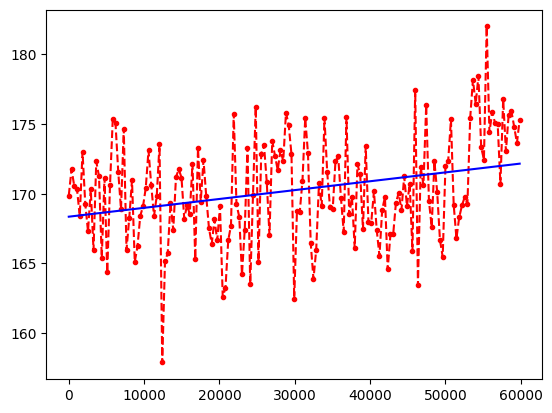

Slope of the trendline: 7.353166802436464e-19


In [90]:
# /home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/gsl.north.time.nc

import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

cwd_north = xr.open_dataset('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/gsl.north.time.nc').squeeze()

# Convert time to a numerical form (number of days since the first date)
time_num = (cwd_north.time - cwd_north.time[0]).astype('timedelta64[D]').astype(float)

# Plot the data
plt.plot(time_num/8.64e13, cwd_north.gsletccdi, 'r.--')

# Fit a linear regression line to the data
slope, intercept = np.polyfit(time_num, cwd_north.gsletccdi, 1)

# Calculate the line values for the plot
trendline = slope * time_num + intercept

# Add the trendline to the plot
plt.plot(time_num/8.64e13, trendline, 'b-')

# Show the plot
plt.show()

# Print the slope value
print(f"Slope of the trendline: {slope}")


In [94]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt

data = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/ncview.dump',skiprows=4,delimiter='\s+',header=None)
data

,0,1
0,0.0,169.870712
1,8760.0,171.746277
2,17520.0,170.560455
3,26280.0,170.315323
4,35040.0,168.397873
...,...,...
160,1401600.0,175.682968
161,1410360.0,175.910156
162,1419120.0,174.803574
163,1427880.0,173.640472


In [95]:
data.columns = ['time','days']

In [96]:
data

,time,days
0,0.0,169.870712
1,8760.0,171.746277
2,17520.0,170.560455
3,26280.0,170.315323
4,35040.0,168.397873
...,...,...
160,1401600.0,175.682968
161,1410360.0,175.910156
162,1419120.0,174.803574
163,1427880.0,173.640472


In [105]:
data['time'] = pd.to_datetime(data['time'])

# data['time'] = data['time'].astype('datetime64[ns]')

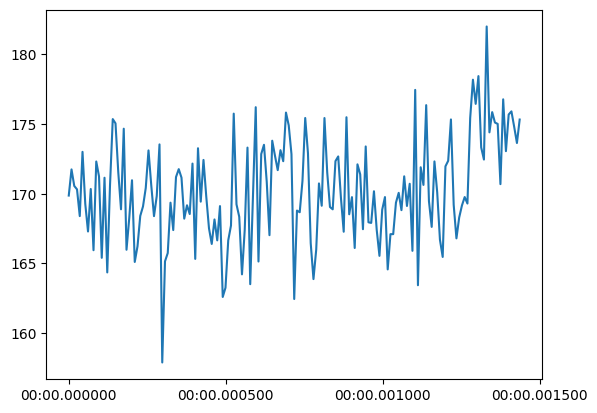

In [106]:
plt.plot(data['time'],data['days'])

In [122]:
data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/data.txt',header=None,delimiter='\s+')
data1


,0,1
0,169.870712,1850
1,171.746277,1851
2,170.560455,1852
3,170.315323,1853
4,168.397873,1854
...,...,...
159,173.054352,2009
160,175.682968,2010
161,175.910156,2011
162,174.803574,2012


In [123]:
data1.columns = ['shit','days']

In [124]:
data1

,shit,days
0,169.870712,1850
1,171.746277,1851
2,170.560455,1852
3,170.315323,1853
4,168.397873,1854
...,...,...
159,173.054352,2009
160,175.682968,2010
161,175.910156,2011
162,174.803574,2012


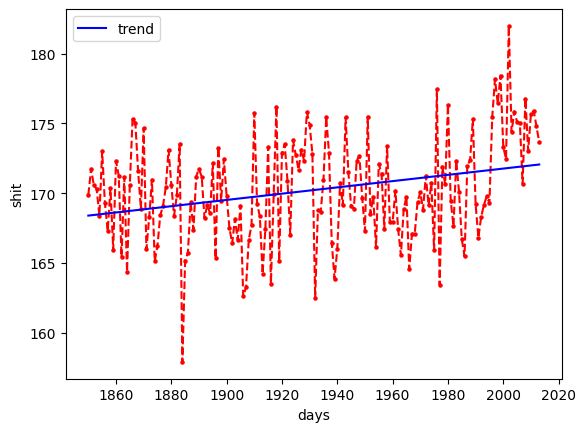

In [133]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/data.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='r', marker='.')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='--', color='r', ax=ax, legend=False)

# Fit a linear trend
trend = np.polyfit(data1['days'], data1['shit'], 1)
trend_line = np.poly1d(trend)

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='-', color='blue', ax=ax)

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


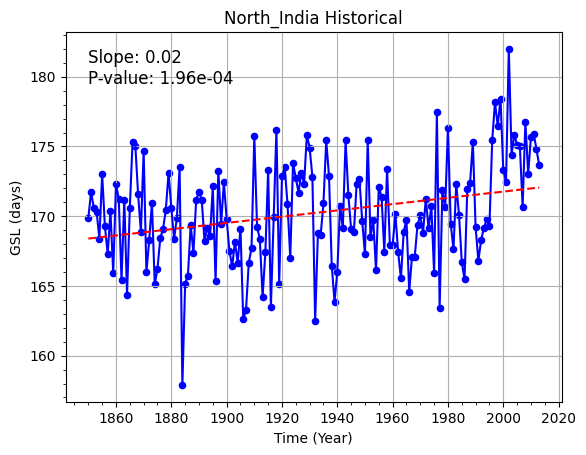

In [149]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/data.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.2f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('North_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


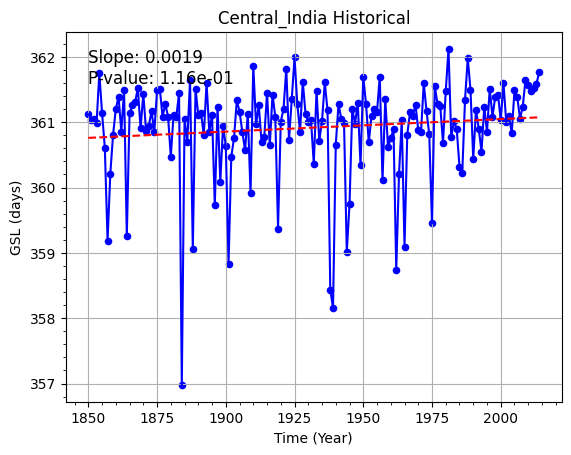

In [169]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/central-hist.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('Central_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


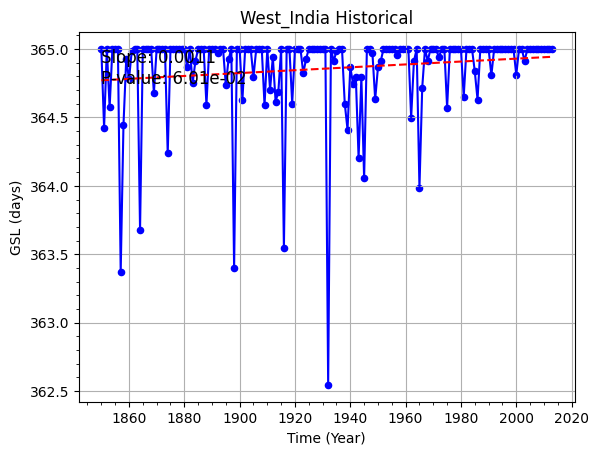

In [171]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/west-hist.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('West_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


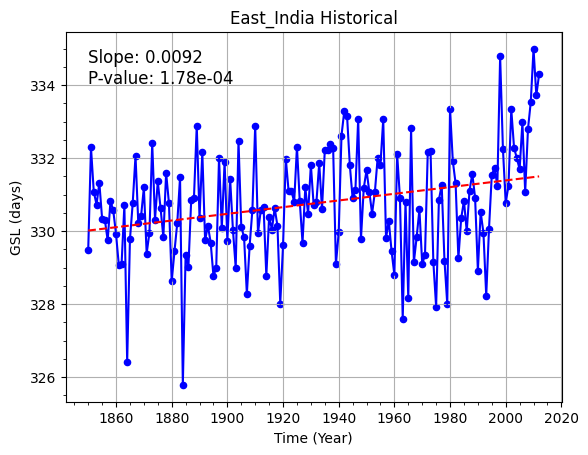

In [173]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/east-hist.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('East_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


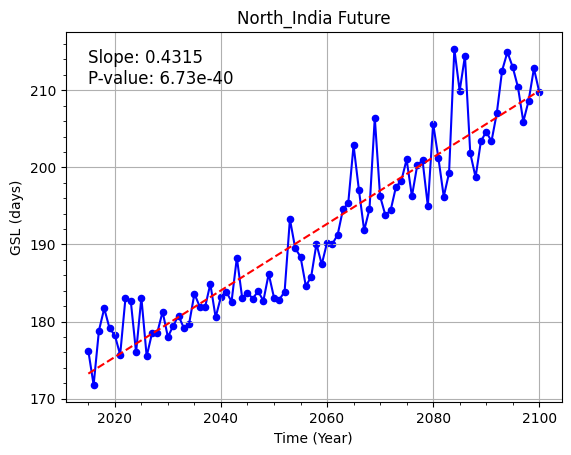

In [174]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/north-fut.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('North_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


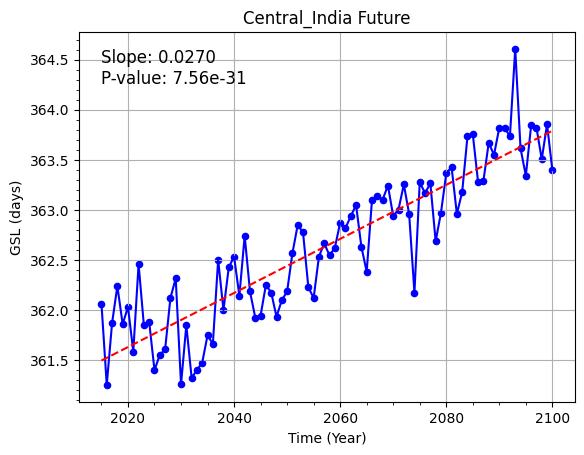

In [175]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/central-fut.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('Central_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


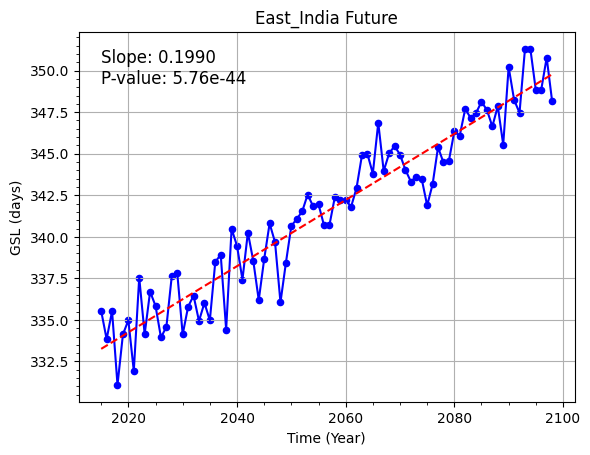

In [177]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/east-fut.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('East_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


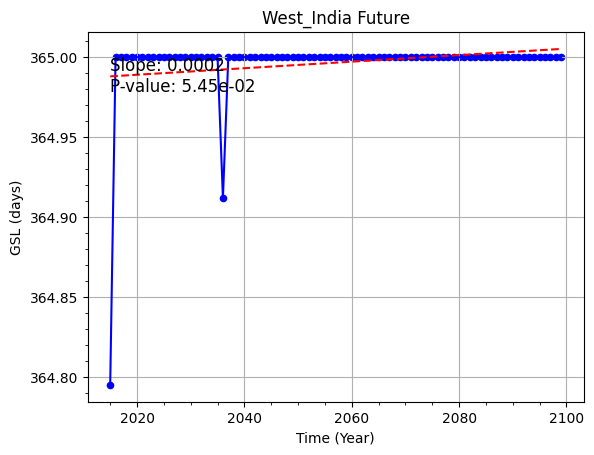

In [178]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/west-fut.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('West_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


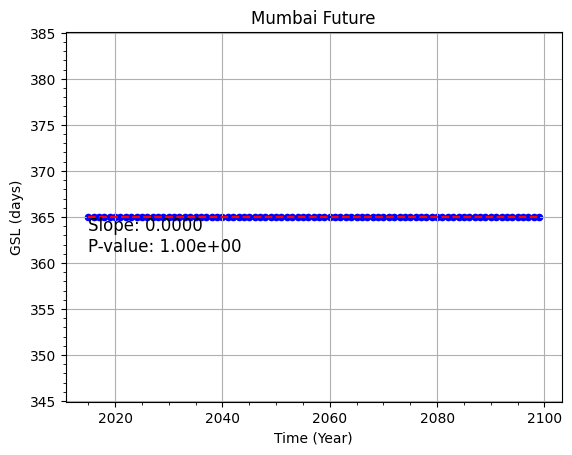

In [184]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/gsl/south.txt', header=None, delimiter='\s+')
data1.columns = ['days', 'shit']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('GSL (days)')
plt.xlabel('Time (Year)')
plt.title('Mumbai Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


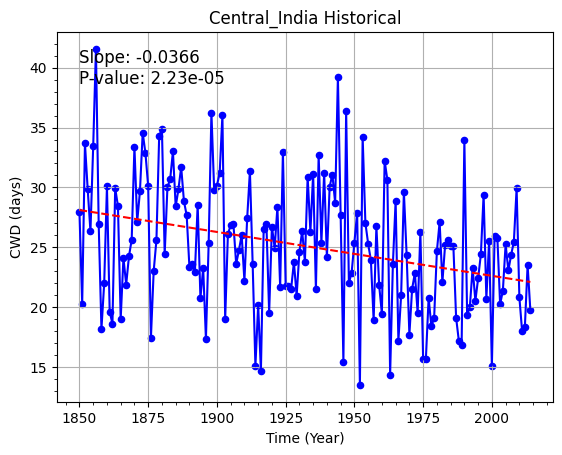

In [205]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/centralhist.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('Central_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


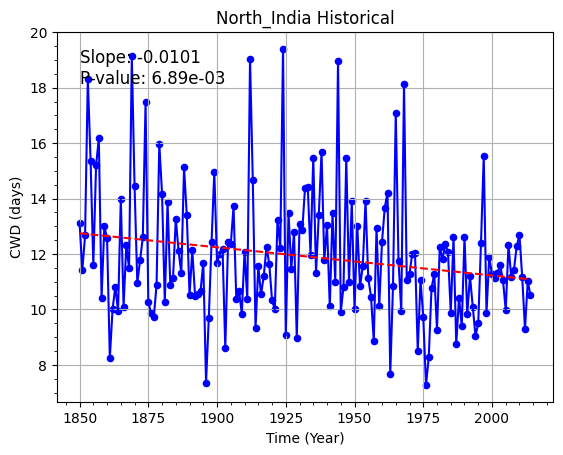

In [206]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/Northhist.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('North_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


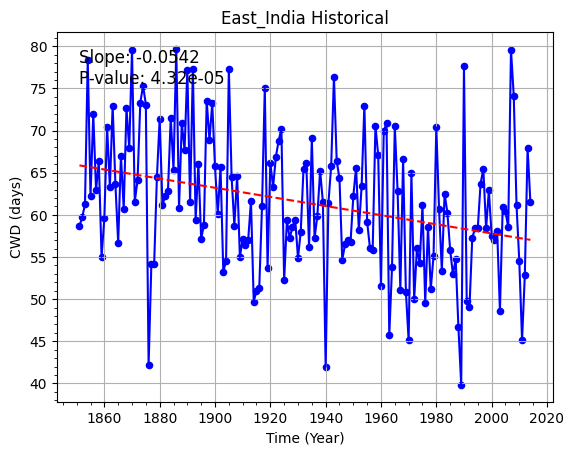

In [207]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/easthist.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('East_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


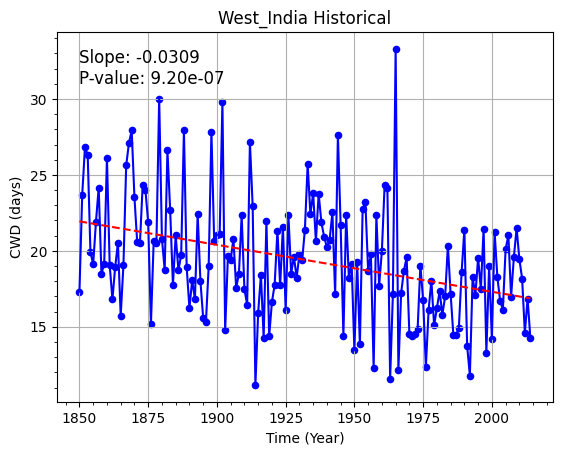

In [208]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/westhist.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('West_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


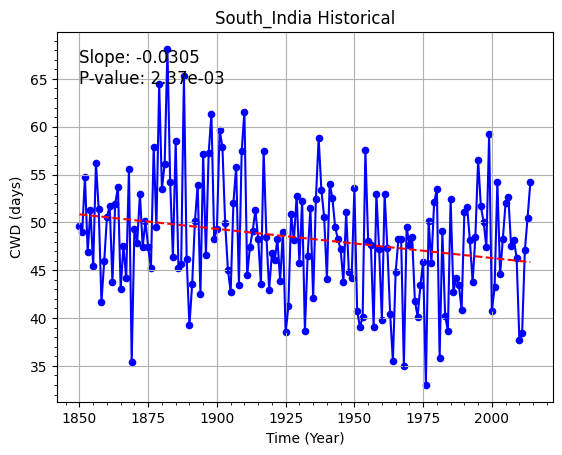

In [209]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/southhist.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('South_India Historical')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


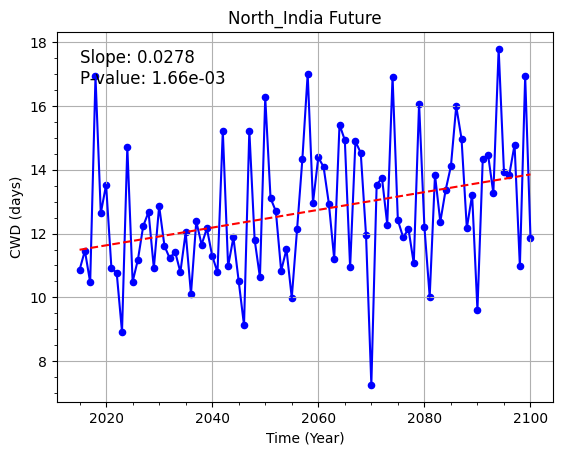

In [241]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/northfut.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('North_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


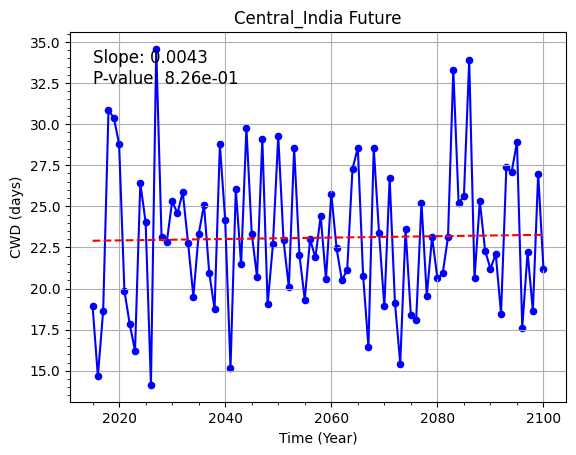

In [242]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/centralfut.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('Central_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


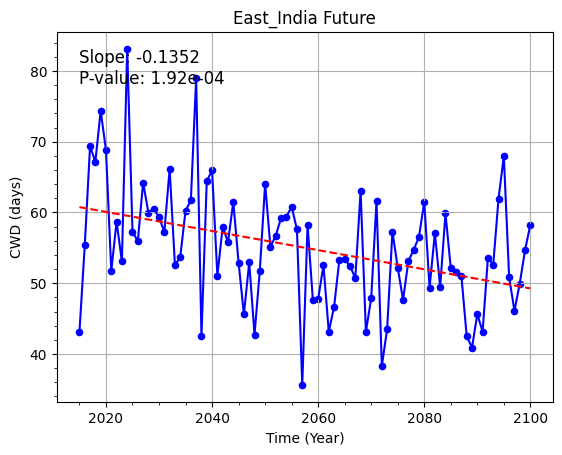

In [243]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/eastfut.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('East_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


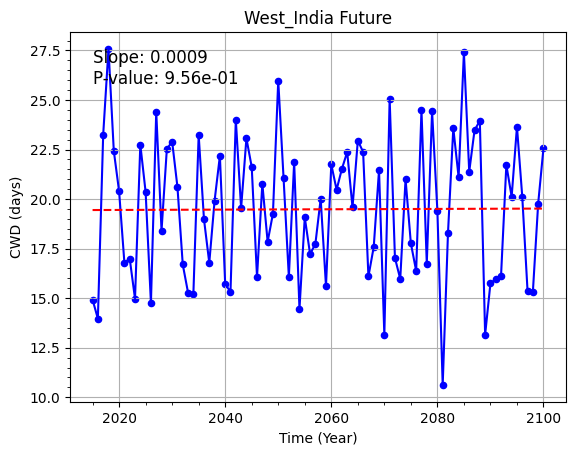

In [244]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/westfut.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('West_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


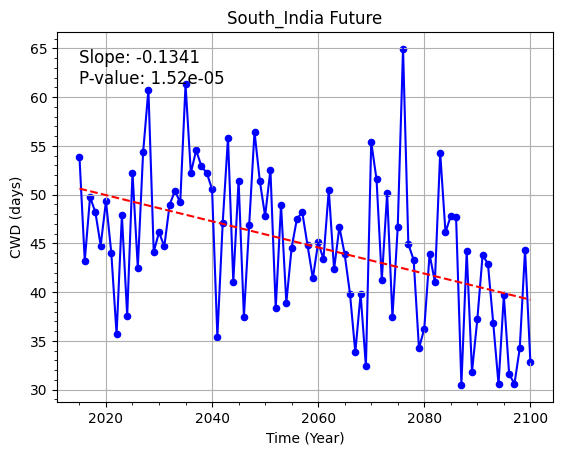

In [245]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/southfut.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('South_India Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


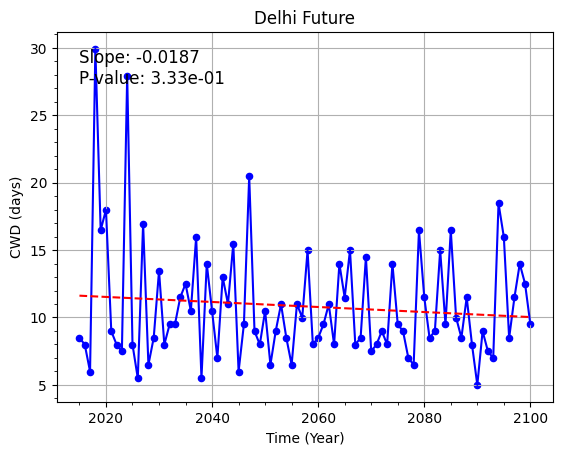

In [248]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/delhi.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('Delhi Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


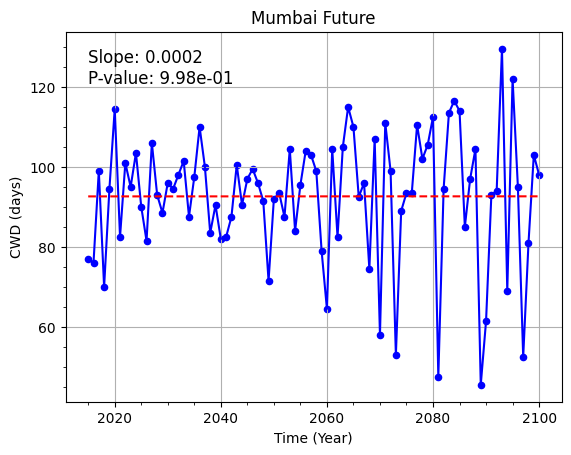

In [249]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/mumbai.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('Mumbai Future')

plt.show()


/home/shiv/.local/lib/python3.10/site-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


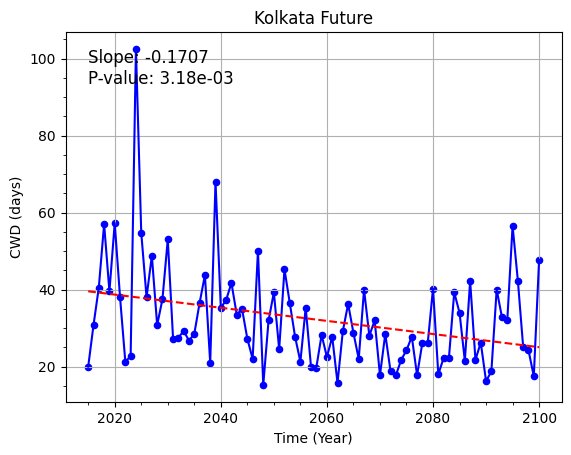

In [250]:
# westhist.txt
# southhist.txt
# westfut.txt
# southfut.txt
# Northhist.txt
# northfut.txt
# easthist.txt
# eastfut.txt
# centralfut.txt
# centralhist (1).txt
# centralhist.txt




import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

data1 = pd.read_csv('/home/shiv/Documents/GitHub/EES405/assignment_4/datasets/cwd/xconv1.94_linux_x86_64/kolkata.txt', header=None, delimiter='\s+')
data1.columns = ['shit', 'days']

# Scatter plot
ax = data1.plot.scatter(x='days', y='shit', color='b', marker='o')

# Dashed line plot connecting points
data1.plot(x='days', y='shit', linestyle='-', color='b', ax=ax, legend=False)

# Fit a linear trend using linregress
slope, intercept, r_value, p_value, std_err = linregress(data1['days'], data1['shit'])
trend_line = np.poly1d([slope, intercept])

# Add the trend line (solid) to the plot
data1['trend'] = trend_line(data1['days'])
data1.plot(x='days', y='trend', linestyle='--', color='red', ax=ax, legend=False)

# Add slope, intercept, and p-value text to the plot
text = f"Slope: {slope:.4f}\nP-value: {p_value:.2e}"
plt.text(data1['days'].min(), data1['shit'].max(), text, fontsize=12, verticalalignment='top', horizontalalignment='left')
plt.grid(True)
plt.minorticks_on()
plt.ylabel('CWD (days)')
plt.xlabel('Time (Year)')
plt.title('Kolkata Future')

plt.show()
